# Packages

In [2]:
import cv2
import json
import cv2
import matplotlib.pyplot as plt

In [1]:
!pip install ultralytics opencv-python numpy torch torchvision


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 977.3/977.3 kB 20.2 MB/s eta 0:00:0000:01


# Dataset

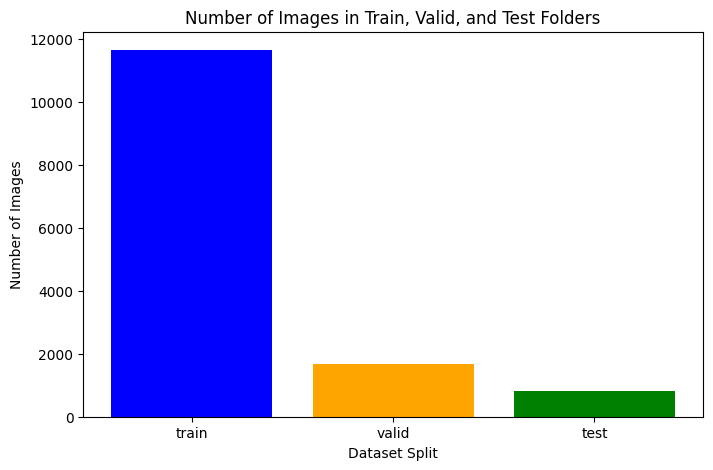

In [3]:
import os
import matplotlib.pyplot as plt

# Path to your dataset
data_path = "/kaggle/input/sixray/sixray_v3"  # Change this to your actual dataset path
folders = ["train", "valid", "test"]

# Count images inside the "images" subfolder of each split
image_counts = {
    folder: len(os.listdir(os.path.join(data_path, folder, "images")))
    for folder in folders
}

# Plot the bar chart
plt.figure(figsize=(8, 5))
plt.bar(image_counts.keys(), image_counts.values(), color=['blue', 'orange', 'green'])
plt.xlabel("Dataset Split")
plt.ylabel("Number of Images")
plt.title("Number of Images in Train, Valid, and Test Folders")
plt.show()


In [4]:
print(f'train images: {len(os.listdir("/kaggle/input/sixray/sixray_v3/train/images/"))}')
print(f'valid images: {len(os.listdir("/kaggle/input/sixray/sixray_v3/valid/images/"))}')
print(f'test images: {len(os.listdir("/kaggle/input/sixray/sixray_v3/test/images/"))}')

train images: 11638
valid images: 1662
test images: 831



📊 Object Count per Class in Each Dataset:

📂 Train Set:
   Gun: 5977 objects
   Knife: 2902 objects
   Pliers: 7279 objects
   Scissors: 1539 objects
   Wrench: 3820 objects

📂 Test Set:
   Gun: 474 objects
   Knife: 169 objects
   Pliers: 524 objects
   Scissors: 120 objects
   Wrench: 306 objects

📂 Valid Set:
   Gun: 888 objects
   Knife: 442 objects
   Pliers: 1110 objects
   Scissors: 206 objects
   Wrench: 530 objects


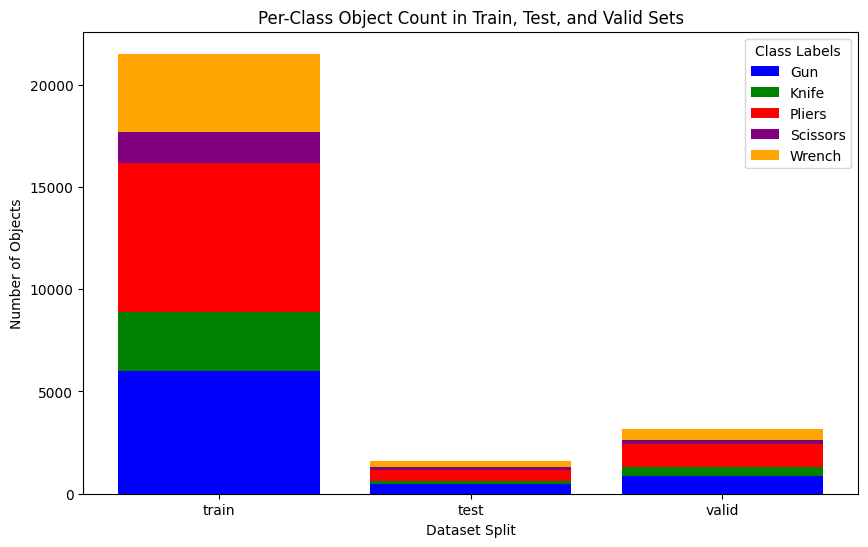

In [5]:
import os
import matplotlib.pyplot as plt
import numpy as np

# Define dataset directories
dataset_dir = "/kaggle/input/sixray/sixray_v3"  # Change if using original dataset
sets = ["train", "test", "valid"]

# Class names (mapped to indices)
class_names = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']
num_classes = len(class_names)

# Dictionary to store object counts per class for each set
class_counts = {dataset: [0] * num_classes for dataset in sets}

# Count objects per class in each dataset
for data_type in sets:
    label_dir = os.path.join(dataset_dir, data_type, "labels")

    if os.path.exists(label_dir):
        for file in os.listdir(label_dir):
            if file.endswith(".txt"):
                file_path = os.path.join(label_dir, file)
                with open(file_path, "r") as f:
                    for line in f:
                        class_id = int(line.split()[0])  # Extract class ID (first value)
                        class_counts[data_type][class_id] += 1  # Increment count

# Print the object count for each class in train, test, and valid
print("\n📊 Object Count per Class in Each Dataset:")
for data_type in sets:
    print(f"\n📂 {data_type.capitalize()} Set:")
    for i, class_name in enumerate(class_names):
        print(f"   {class_name}: {class_counts[data_type][i]} objects")

# Plot the results
x_labels = sets
x = np.arange(len(x_labels))

fig, ax = plt.subplots(figsize=(10, 6))

# Stacked bar chart
bottom = np.zeros(len(sets))
colors = ['blue', 'green', 'red', 'purple', 'orange']  # Adjust colors if more classes

for class_id in range(num_classes):
    ax.bar(x, [class_counts[dataset][class_id] for dataset in sets], 
           label=class_names[class_id], bottom=bottom, color=colors[class_id])
    bottom += np.array([class_counts[dataset][class_id] for dataset in sets])

# Labels and title
ax.set_xlabel("Dataset Split")
ax.set_ylabel("Number of Objects")
ax.set_title("Per-Class Object Count in Train, Test, and Valid Sets")
ax.set_xticks(x)
ax.set_xticklabels(x_labels)
ax.legend(title="Class Labels")

plt.show()


## Training data

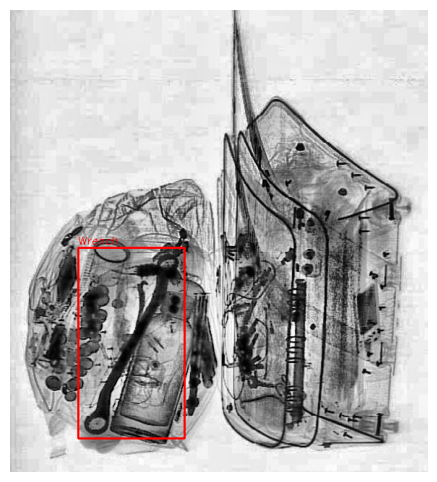

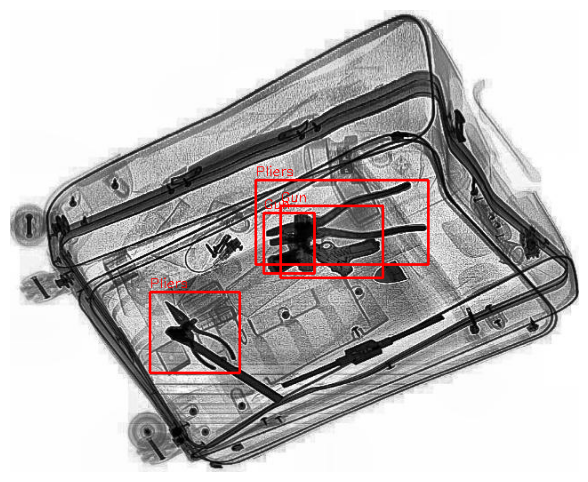

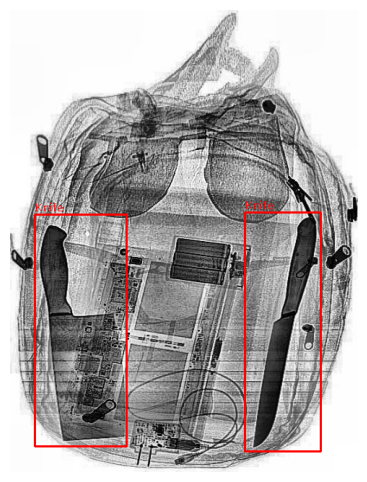

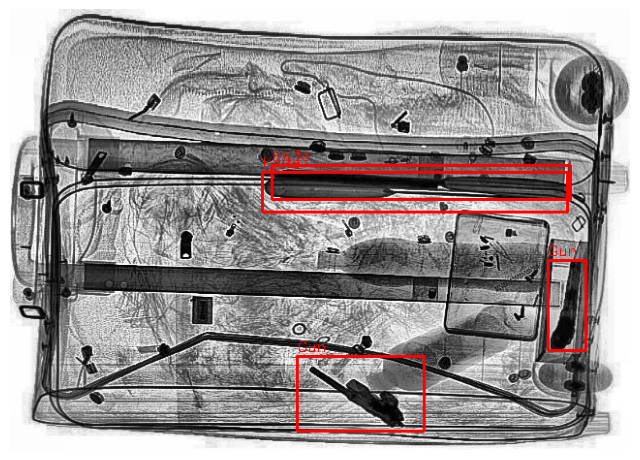

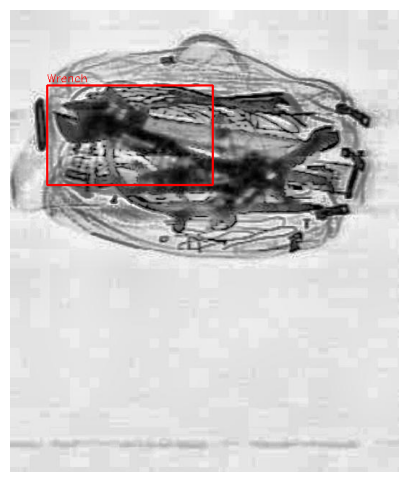

In [6]:
import os
import cv2
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/kaggle/input/sixray/sixray_v3"
split = "train"  # Change to 'test' or 'valid' as needed

# Manually define class names (Modify according to your dataset)
class_names = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Get list of image files
image_folder = os.path.join(dataset_path, split, "images")
label_folder = os.path.join(dataset_path, split, "labels")

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Function to read labels and draw boxes with class names
def draw_boxes(image_path, label_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    h, w, _ = image.shape

    # Read label file
    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        values = line.strip().split()
        class_id = int(values[0])  # Class index (assuming YOLO format)
        
        # Ensure class_id is within bounds
        if class_id >= len(class_names):
            class_name = "Unknown"
        else:
            class_name = class_names[class_id]  # Get class name

        x_center, y_center, box_w, box_h = map(float, values[1:])

        # Convert YOLO format to pixel coordinates
        x1 = int((x_center - box_w / 2) * w)
        y1 = int((y_center - box_h / 2) * h)
        x2 = int((x_center + box_w / 2) * w)
        y2 = int((y_center + box_h / 2) * h)

        # Draw bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(image, class_name, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # Show image with boxes
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# Show a few sample images
for i in range(20,25):  # Display 3 images
    img_file = image_files[i]
    img_path = os.path.join(image_folder, img_file)
    label_path = os.path.join(label_folder, os.path.splitext(img_file)[0] + ".txt")

    if os.path.exists(label_path):
        draw_boxes(img_path, label_path)
    else:
        print(f"Label file missing for {img_file}")


## Valid data

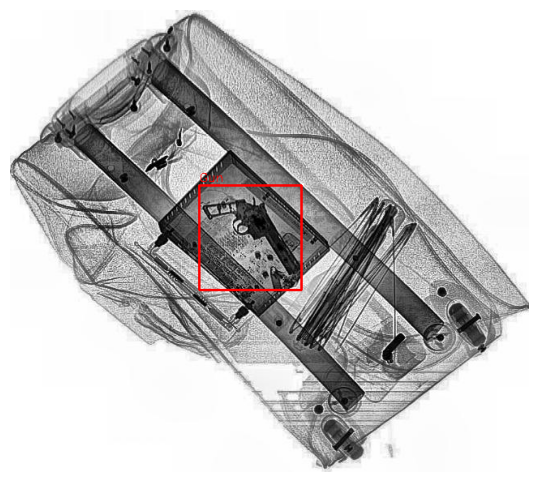

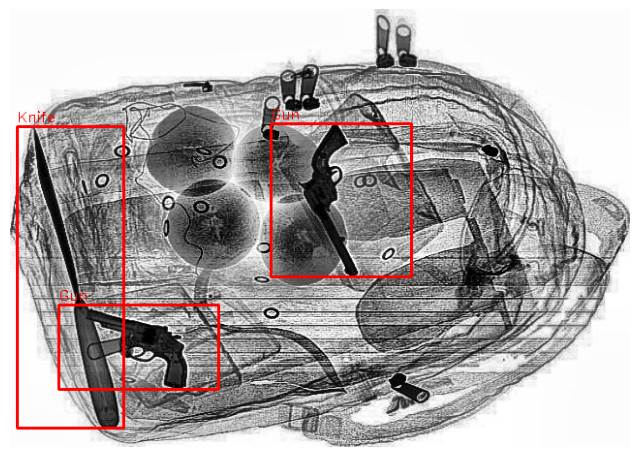

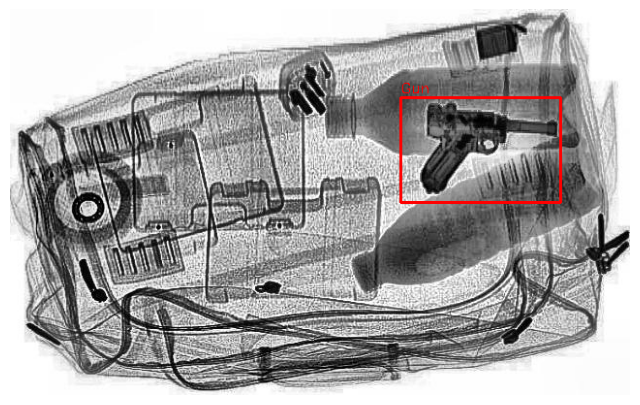

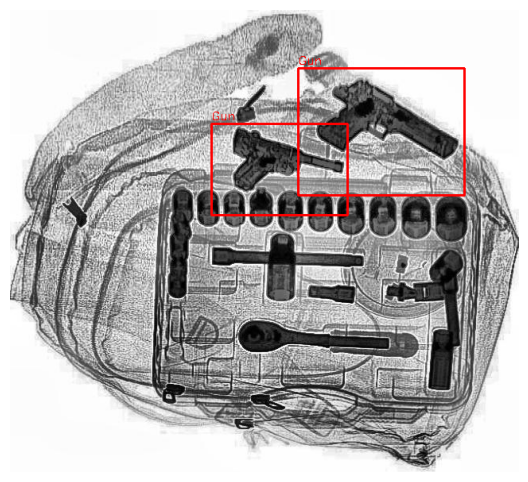

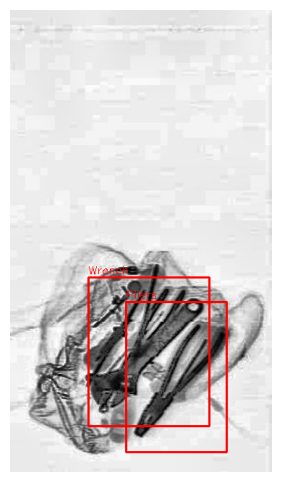

In [7]:
import os
import cv2
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/kaggle/input/sixray/sixray_v3"
split = "valid"  # Change to 'test' or 'valid' as needed

# Manually define class names (Modify according to your dataset)
class_names = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Get list of image files
image_folder = os.path.join(dataset_path, split, "images")
label_folder = os.path.join(dataset_path, split, "labels")

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Function to read labels and draw boxes with class names
def draw_boxes(image_path, label_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    h, w, _ = image.shape

    # Read label file
    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        values = line.strip().split()
        class_id = int(values[0])  # Class index (assuming YOLO format)
        
        # Ensure class_id is within bounds
        if class_id >= len(class_names):
            class_name = "Unknown"
        else:
            class_name = class_names[class_id]  # Get class name

        x_center, y_center, box_w, box_h = map(float, values[1:])

        # Convert YOLO format to pixel coordinates
        x1 = int((x_center - box_w / 2) * w)
        y1 = int((y_center - box_h / 2) * h)
        x2 = int((x_center + box_w / 2) * w)
        y2 = int((y_center + box_h / 2) * h)

        # Draw bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(image, class_name, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # Show image with boxes
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# Show a few sample images
for i in range(20,25):  # Display 3 images
    img_file = image_files[i]
    img_path = os.path.join(image_folder, img_file)
    label_path = os.path.join(label_folder, os.path.splitext(img_file)[0] + ".txt")

    if os.path.exists(label_path):
        draw_boxes(img_path, label_path)
    else:
        print(f"Label file missing for {img_file}")


## Testing data

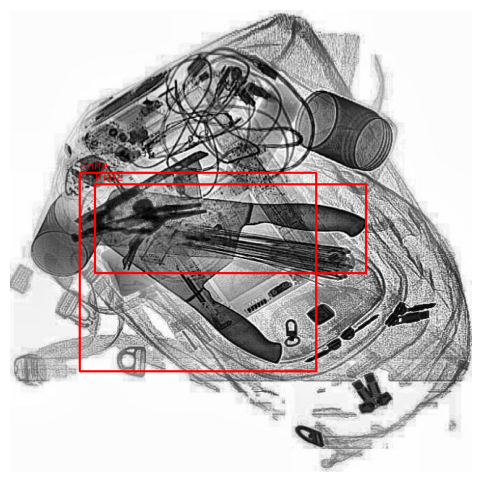

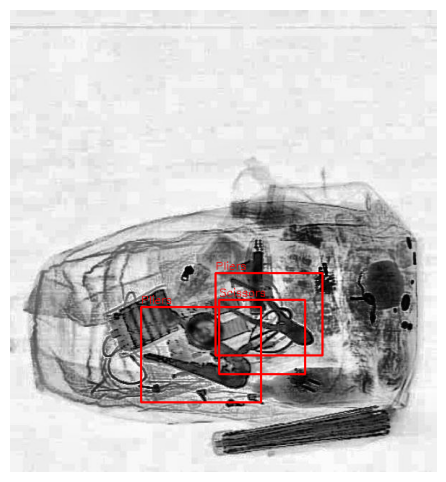

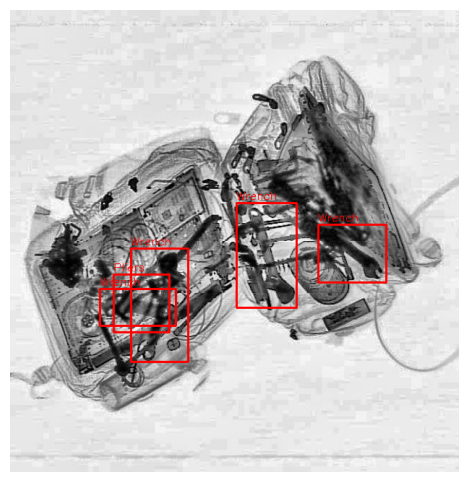

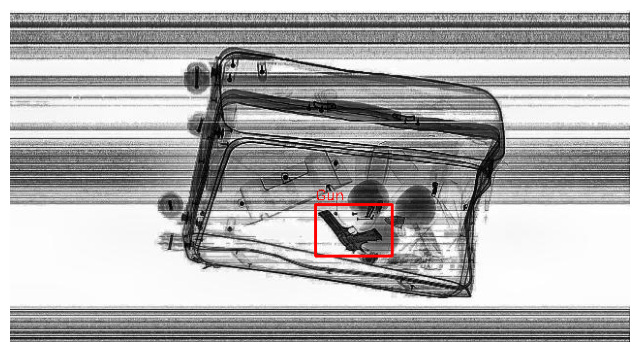

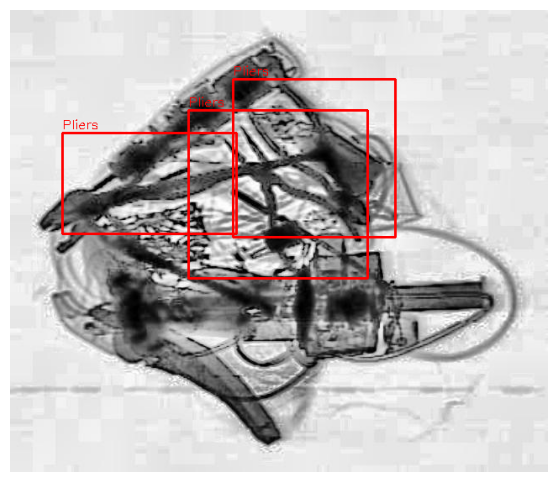

In [8]:
import os
import cv2
import matplotlib.pyplot as plt

# Define dataset path
dataset_path = "/kaggle/input/sixray/sixray_v3"
split = "test"  # Change to 'test' or 'valid' as needed

# Manually define class names (Modify according to your dataset)
class_names = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Get list of image files
image_folder = os.path.join(dataset_path, split, "images")
label_folder = os.path.join(dataset_path, split, "labels")

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Function to read labels and draw boxes with class names
def draw_boxes(image_path, label_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    h, w, _ = image.shape

    # Read label file
    with open(label_path, "r") as f:
        lines = f.readlines()

    for line in lines:
        values = line.strip().split()
        class_id = int(values[0])  # Class index (assuming YOLO format)
        
        # Ensure class_id is within bounds
        if class_id >= len(class_names):
            class_name = "Unknown"
        else:
            class_name = class_names[class_id]  # Get class name

        x_center, y_center, box_w, box_h = map(float, values[1:])

        # Convert YOLO format to pixel coordinates
        x1 = int((x_center - box_w / 2) * w)
        y1 = int((y_center - box_h / 2) * h)
        x2 = int((x_center + box_w / 2) * w)
        y2 = int((y_center + box_h / 2) * h)

        # Draw bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(image, class_name, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

    # Show image with boxes
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

# Show a few sample images
for i in range(20,25):  # Display 3 images
    img_file = image_files[i]
    img_path = os.path.join(image_folder, img_file)
    label_path = os.path.join(label_folder, os.path.splitext(img_file)[0] + ".txt")

    if os.path.exists(label_path):
        draw_boxes(img_path, label_path)
    else:
        print(f"Label file missing for {img_file}")


## Yolo model training

In [9]:
from ultralytics import YOLO

model1 = YOLO("yolov8n.pt")  # Load pre-trained model
results1=model1.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=50, batch=16)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 315MB/s]

Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)


engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/sixray/sixray_v3/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False, optimize=Fa

100%|██████████| 755k/755k [00:00<00:00, 129MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 353MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/sixray/sixray_v3/train/labels... 11638 images, 115 backgrounds, 0 corrupt: 100%|██████████| 11638/11638 [00:48<00:00, 239.18it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/sixray/sixray_v3/valid/labels... 1662 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1662/1662 [00:06<00:00, 250.07it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/valid is not writeable, cache not saved.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.21G      1.849      2.863      1.745         20        640: 100%|██████████| 728/728 [02:24<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:11<00:00,  4.66it/s]


                   all       1662       3176       0.41      0.381      0.377      0.181

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      3.12G      1.781      2.142      1.717         15        640: 100%|██████████| 728/728 [02:15<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.95it/s]


                   all       1662       3176      0.541      0.494      0.504      0.256

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      3.12G      1.751      1.972       1.71         23        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.69it/s]


                   all       1662       3176      0.612      0.464      0.533      0.277

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      3.12G      1.703      1.847      1.678         17        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]


                   all       1662       3176      0.639      0.546       0.61      0.326

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      3.12G      1.643      1.724      1.638         28        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.88it/s]


                   all       1662       3176      0.682      0.583      0.647      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      3.12G      1.601      1.636      1.608         22        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.75it/s]


                   all       1662       3176      0.693      0.608       0.67      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      3.12G      1.557      1.553      1.577         22        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]


                   all       1662       3176      0.725      0.627      0.694      0.402

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      3.12G      1.533      1.507      1.564         19        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.87it/s]


                   all       1662       3176      0.764      0.634      0.725      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      3.12G      1.498      1.452      1.533         39        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]


                   all       1662       3176      0.798      0.627       0.73      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      3.12G      1.474      1.396      1.513         22        640: 100%|██████████| 728/728 [02:14<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.73it/s]


                   all       1662       3176      0.805      0.648      0.754      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      3.12G      1.456      1.362      1.502         15        640: 100%|██████████| 728/728 [02:14<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.69it/s]


                   all       1662       3176      0.788      0.653       0.76      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      3.12G       1.43       1.32      1.478         23        640: 100%|██████████| 728/728 [02:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.80it/s]


                   all       1662       3176      0.784      0.666      0.763      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      3.12G      1.413      1.293      1.463         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.88it/s]

                   all       1662       3176      0.817      0.671      0.778      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      3.12G      1.393      1.271      1.456         22        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.92it/s]


                   all       1662       3176      0.828      0.679      0.787      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      3.12G      1.379      1.241      1.438         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]


                   all       1662       3176      0.789      0.711      0.799       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      3.12G      1.365      1.223       1.43         16        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.86it/s]

                   all       1662       3176      0.828      0.716      0.809      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      3.12G      1.351      1.192      1.423         28        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.83it/s]

                   all       1662       3176      0.807      0.735      0.818      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      3.12G      1.332      1.166      1.407         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]

                   all       1662       3176      0.822      0.721      0.816      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      3.12G      1.326      1.163      1.404         15        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.95it/s]

                   all       1662       3176      0.856      0.724      0.827      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      3.12G      1.314      1.134      1.398         27        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.77it/s]

                   all       1662       3176      0.864      0.727      0.833      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      3.12G      1.293      1.123      1.379         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.99it/s]

                   all       1662       3176       0.86       0.74      0.837      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      3.12G      1.287      1.103      1.373         33        640: 100%|██████████| 728/728 [02:15<00:00,  5.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]

                   all       1662       3176      0.853       0.75      0.843      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      3.12G      1.279       1.09      1.363         14        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.90it/s]

                   all       1662       3176      0.847      0.736      0.842      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      3.12G      1.265      1.074      1.356         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.87it/s]

                   all       1662       3176      0.859      0.743      0.849      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      3.12G       1.25      1.051      1.348         21        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]

                   all       1662       3176      0.835      0.764      0.852      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      3.12G      1.244      1.046      1.341         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.09it/s]

                   all       1662       3176      0.865      0.745      0.852      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      3.12G      1.237      1.033      1.335         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.86it/s]


                   all       1662       3176      0.858      0.767      0.858       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      3.12G      1.216      1.012      1.322         34        640: 100%|██████████| 728/728 [02:13<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.71it/s]


                   all       1662       3176      0.861      0.772      0.863      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      3.12G      1.218      1.012      1.324         16        640: 100%|██████████| 728/728 [02:14<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.90it/s]

                   all       1662       3176      0.888      0.759      0.863      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      3.12G      1.212     0.9969      1.318         21        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.872      0.763      0.866       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      3.12G      1.186     0.9725      1.299         24        640: 100%|██████████| 728/728 [02:14<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]

                   all       1662       3176      0.895      0.754      0.867      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      3.12G      1.183      0.969      1.294         31        640: 100%|██████████| 728/728 [02:14<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.86it/s]

                   all       1662       3176       0.89      0.769      0.876      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.12G      1.169     0.9545      1.282         19        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.20it/s]

                   all       1662       3176      0.871      0.786      0.872      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.12G      1.173     0.9537      1.286         23        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]

                   all       1662       3176      0.888      0.771      0.876      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.12G      1.163     0.9435      1.279         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.869      0.794      0.875      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.12G      1.154     0.9362      1.278         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.09it/s]

                   all       1662       3176      0.852      0.813      0.879      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      3.12G      1.141     0.9172      1.266         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]

                   all       1662       3176      0.873      0.803      0.879      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      3.12G      1.134     0.9165      1.262         21        640: 100%|██████████| 728/728 [02:14<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]


                   all       1662       3176      0.899      0.803      0.885      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.12G      1.118     0.8998      1.251         21        640: 100%|██████████| 728/728 [02:14<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.89it/s]

                   all       1662       3176       0.91      0.789      0.886      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      3.12G      1.117     0.8983      1.252         19        640: 100%|██████████| 728/728 [02:14<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176      0.881      0.808      0.888      0.623


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.12G     0.9947     0.6721        1.2         12        640: 100%|██████████| 728/728 [02:14<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.93it/s]

                   all       1662       3176      0.897      0.795      0.887      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.12G     0.9796      0.656      1.194         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.94it/s]

                   all       1662       3176       0.88      0.811      0.887      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      3.12G     0.9636     0.6439      1.183          7        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.05it/s]

                   all       1662       3176      0.874      0.815      0.888      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      3.12G     0.9478     0.6342      1.171         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.895      0.808      0.892      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.12G     0.9392     0.6271      1.168          8        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.88it/s]

                   all       1662       3176      0.905       0.81      0.892      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      3.12G     0.9266     0.6135      1.155         14        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176       0.91      0.807      0.893      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.12G     0.9182     0.6067      1.153         10        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.78it/s]

                   all       1662       3176      0.919      0.797      0.892      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.12G      0.911     0.5972      1.146         11        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.54it/s]

                   all       1662       3176      0.898      0.811      0.892      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      3.12G     0.9015     0.5936       1.14          8        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.08it/s]

                   all       1662       3176      0.908      0.808      0.891      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.12G     0.8922     0.5875      1.135          8        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]

                   all       1662       3176      0.905      0.812      0.894      0.644



50 epochs completed in 1.986 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:10<00:00,  5.12it/s]


                   all       1662       3176      0.904      0.812      0.894      0.644
                   Gun        551        888      0.957      0.939       0.98      0.757
                 Knife        291        442      0.891      0.792      0.866       0.62
                Pliers        794       1110      0.918      0.809      0.912      0.647
              Scissors        178        206      0.872      0.801       0.88      0.591
                Wrench        392        530      0.884      0.717      0.831      0.605


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train


### results of training model1

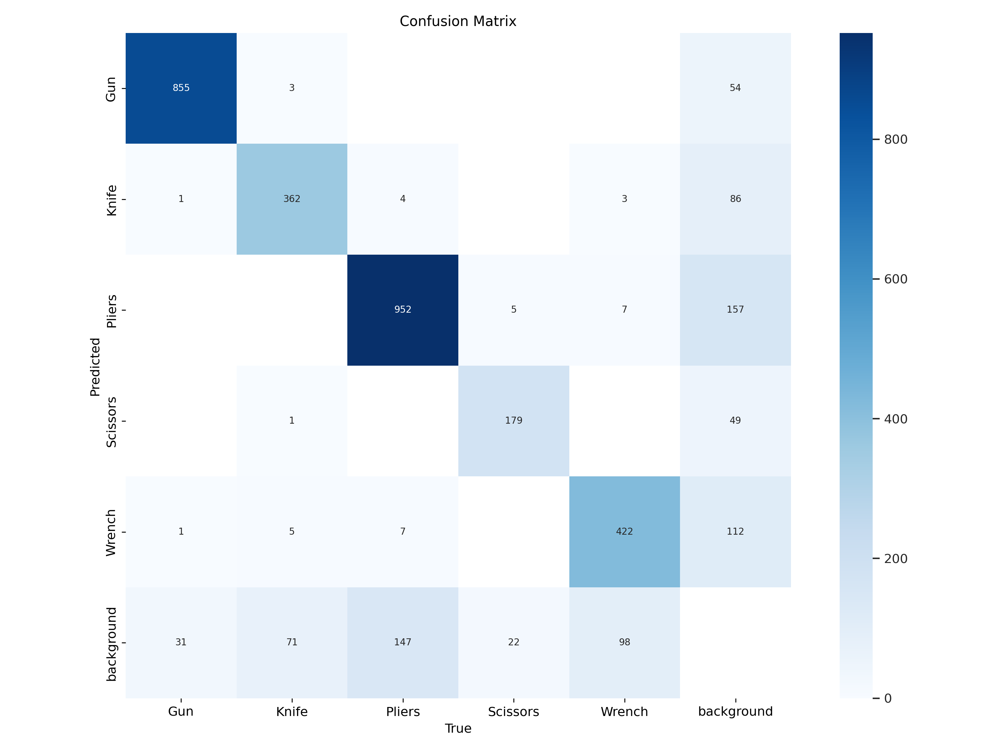

In [10]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train/confusion_matrix.png', width=700)


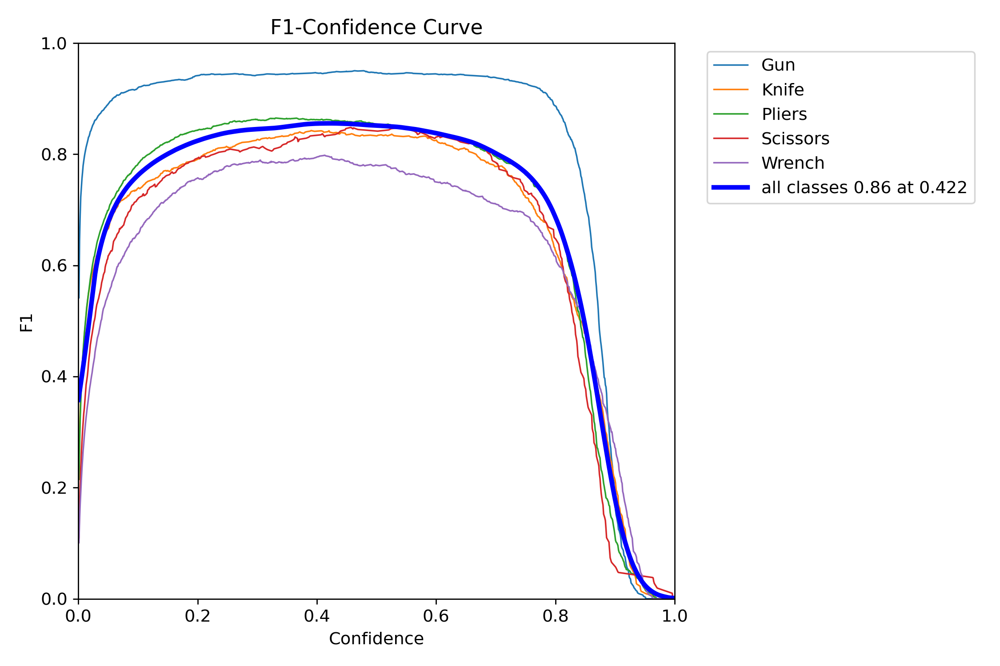

In [11]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train/F1_curve.png', width=700)


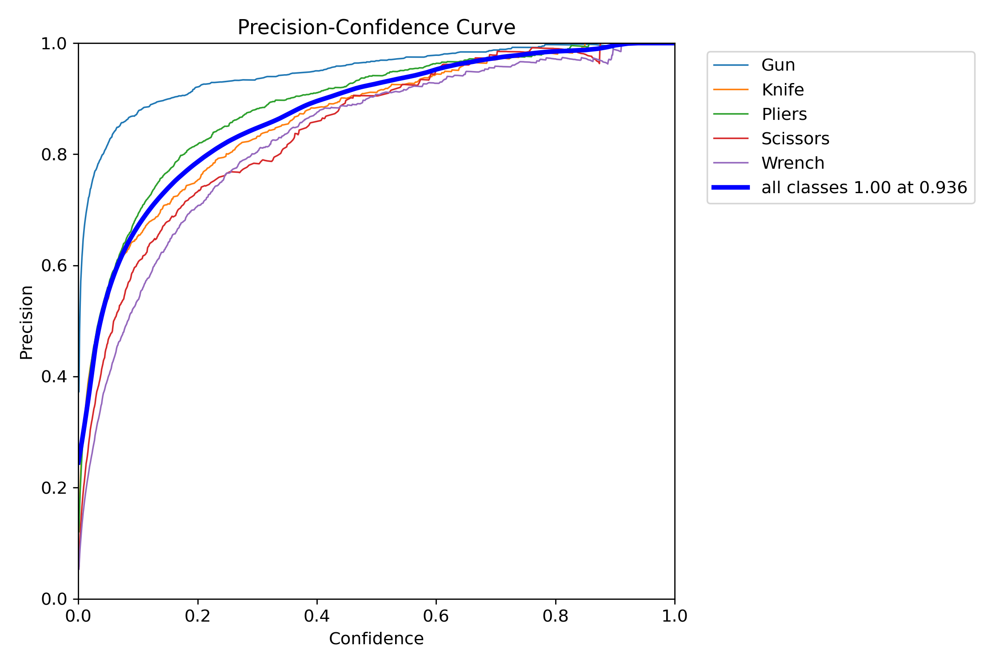

In [12]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train/P_curve.png', width=700)


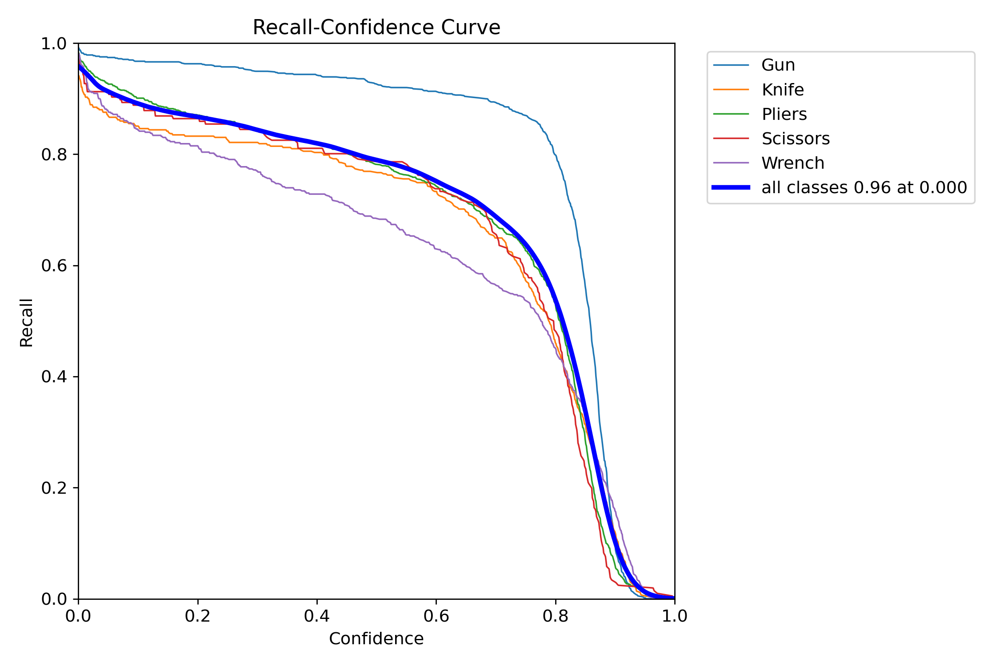

In [13]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train/R_curve.png', width=700)


### Model1 testing

In [14]:
model1.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/sixray/sixray_v3/test/labels... 831 images, 2 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:03<00:00, 227.01it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/test is not writeable, cache not saved.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:06<00:00,  8.36it/s]


                   all        831       1593      0.926      0.809       0.89      0.643
                   Gun        288        474       0.98      0.964      0.988      0.772
                 Knife        111        169      0.907      0.769      0.866      0.592
                Pliers        387        524      0.935      0.818      0.909      0.664
              Scissors         97        120      0.933        0.8      0.866      0.595
                Wrench        214        306      0.876      0.694      0.823      0.593


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.3ms preprocess, 3.0ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1833388820>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

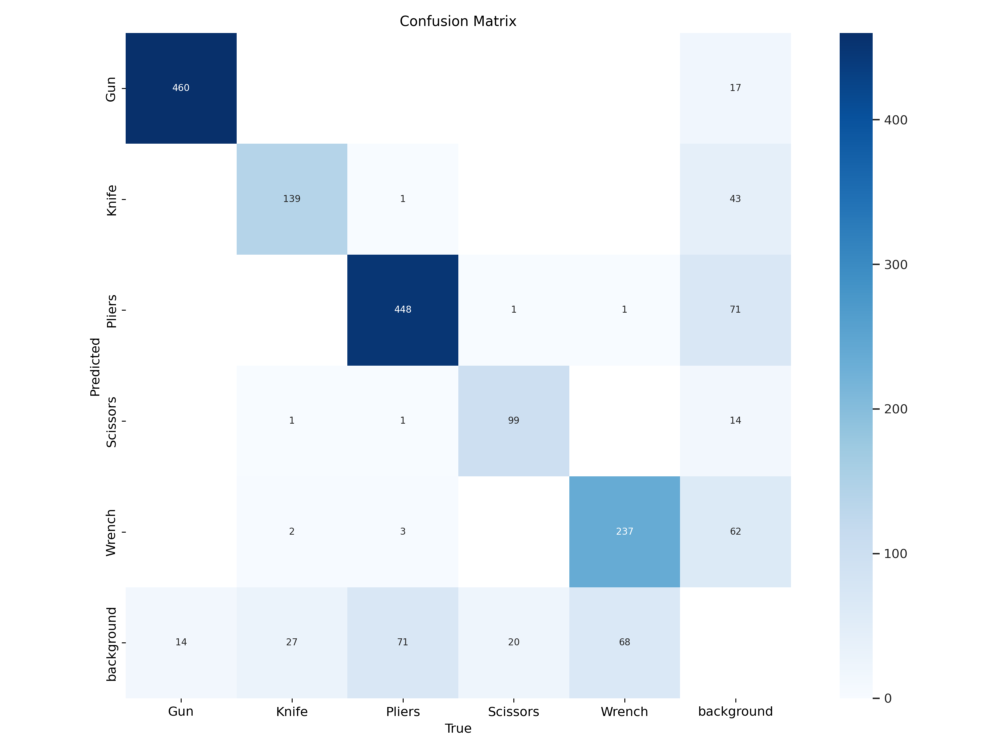

In [15]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train2/confusion_matrix.png', width=700)



image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P04090_jpg.rf.ce056770169b83e8da0eb5bcf90a7e2f.jpg: 640x352 1 Wrench, 34.7ms
Speed: 1.3ms preprocess, 34.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 352)


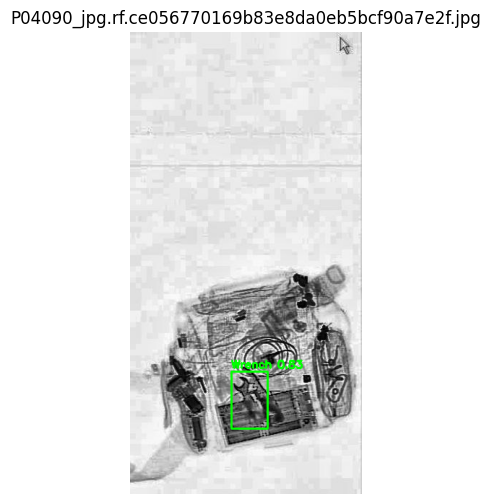


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00566_jpg.rf.f6f7244b34dc19538bbbcf6ee3a0afe9.jpg: 640x640 2 Knifes, 6.8ms
Speed: 1.6ms preprocess, 6.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


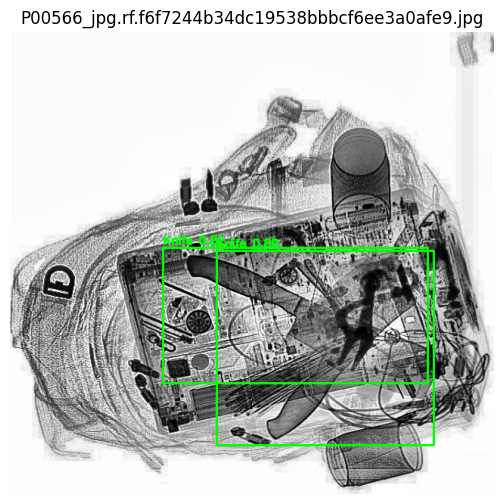


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P08192_jpg.rf.7d44114194ea0b181e8b6f624e3b43e5.jpg: 576x640 1 Scissors, 35.7ms
Speed: 1.6ms preprocess, 35.7ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


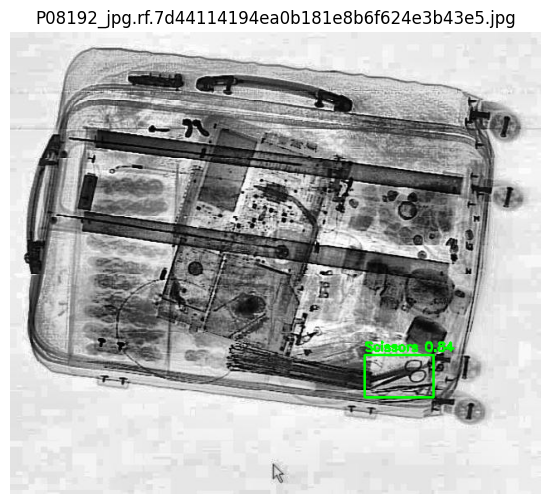


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00937_jpg.rf.e5686c9d95f2bbe37f7481ad72b65af5.jpg: 640x608 2 Guns, 1 Wrench, 34.7ms
Speed: 1.6ms preprocess, 34.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 608)


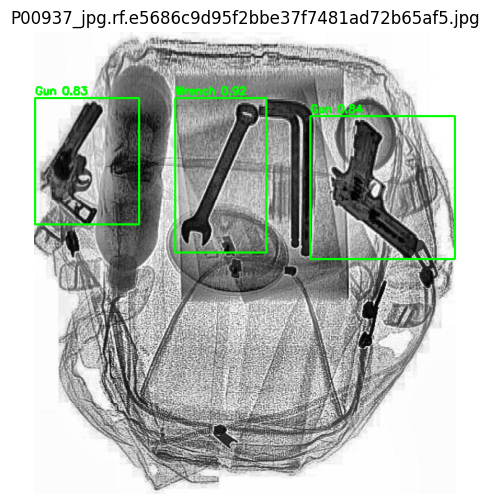


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P01417_jpg.rf.77884899d17be8dc4450d0cd49fc31c0.jpg: 640x640 2 Guns, 7.0ms
Speed: 1.6ms preprocess, 7.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


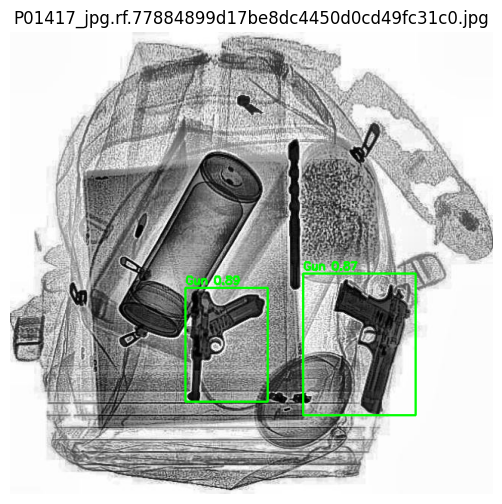

In [16]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model1(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()


### Model1 prediction on images out of data


0: 544x640 (no detections), 34.3ms
Speed: 2.4ms preprocess, 34.3ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)


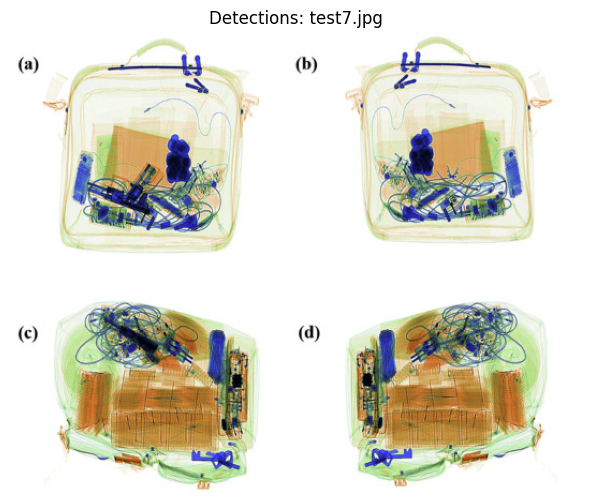


0: 640x640 1 Gun, 1 Knife, 1 Wrench, 7.0ms
Speed: 2.6ms preprocess, 7.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


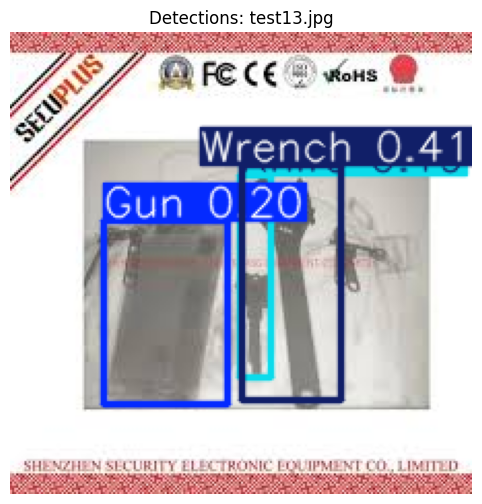


0: 512x640 (no detections), 33.3ms
Speed: 2.8ms preprocess, 33.3ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


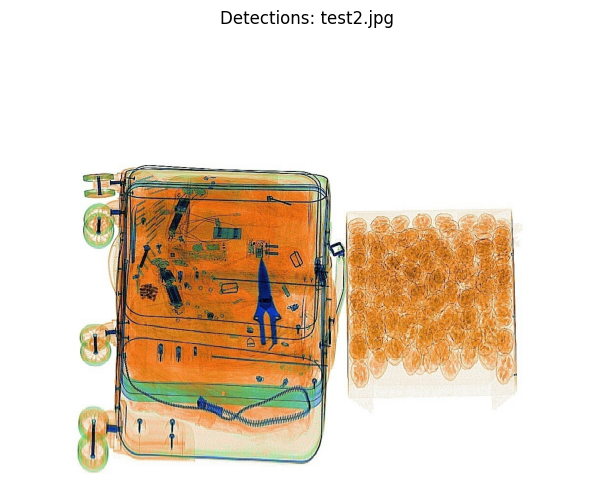


0: 576x640 3 Guns, 1 Knife, 3 Plierss, 3 Scissorss, 7.1ms
Speed: 3.0ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)


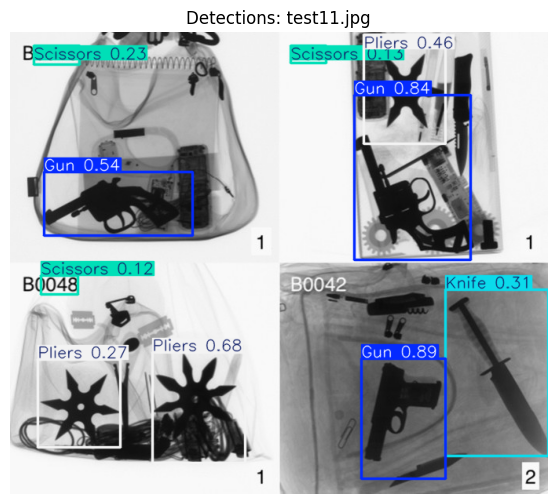


0: 608x640 5 Guns, 1 Pliers, 32.7ms
Speed: 2.7ms preprocess, 32.7ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)


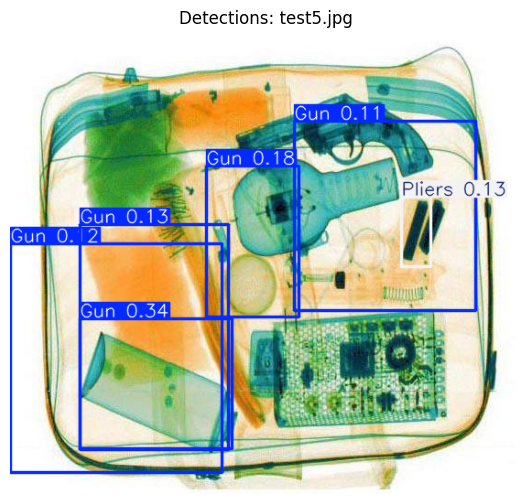


0: 448x640 1 Gun, 3 Knifes, 3 Scissorss, 1 Wrench, 32.9ms
Speed: 2.1ms preprocess, 32.9ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


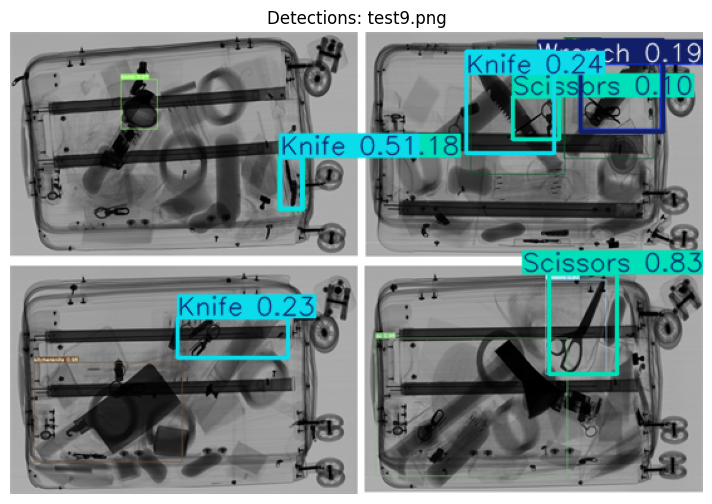


0: 512x640 1 Gun, 7.1ms
Speed: 2.7ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)


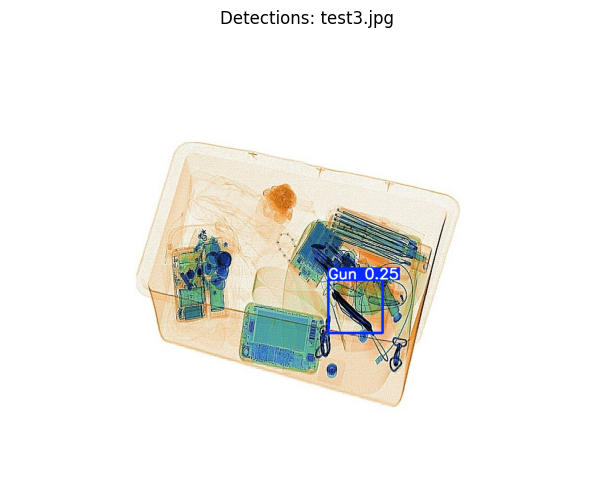


0: 640x576 1 Pliers, 35.5ms
Speed: 2.1ms preprocess, 35.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


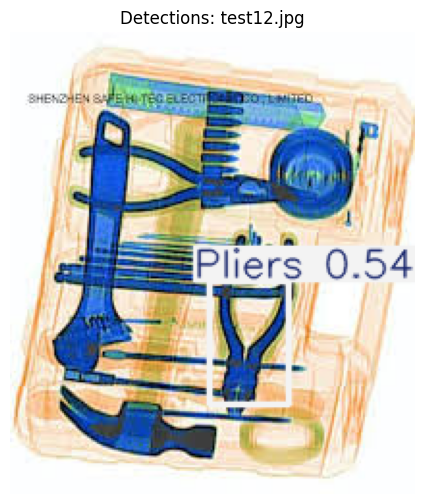


0: 288x640 2 Guns, 1 Scissors, 32.3ms
Speed: 2.5ms preprocess, 32.3ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


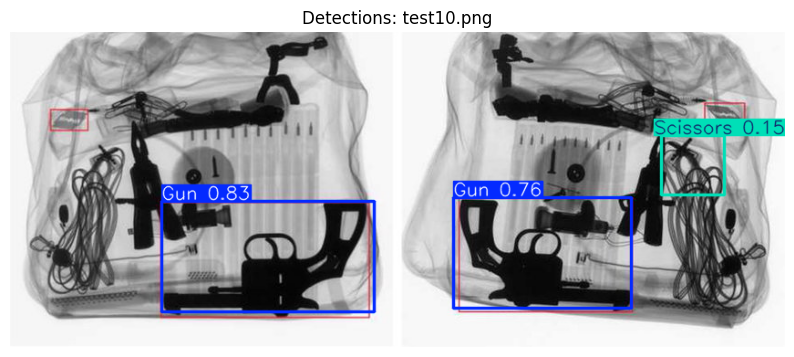


0: 224x640 (no detections), 32.4ms
Speed: 1.1ms preprocess, 32.4ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)


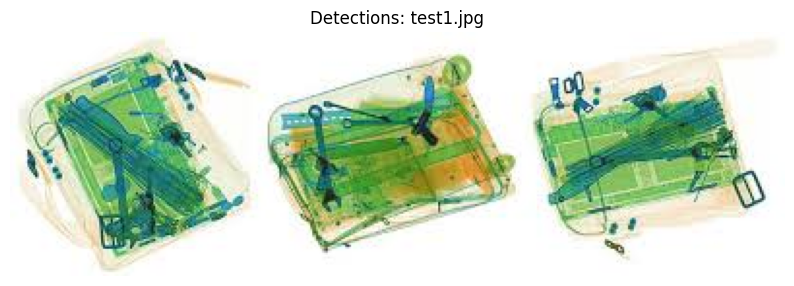


0: 512x640 1 Knife, 6.9ms
Speed: 2.9ms preprocess, 6.9ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


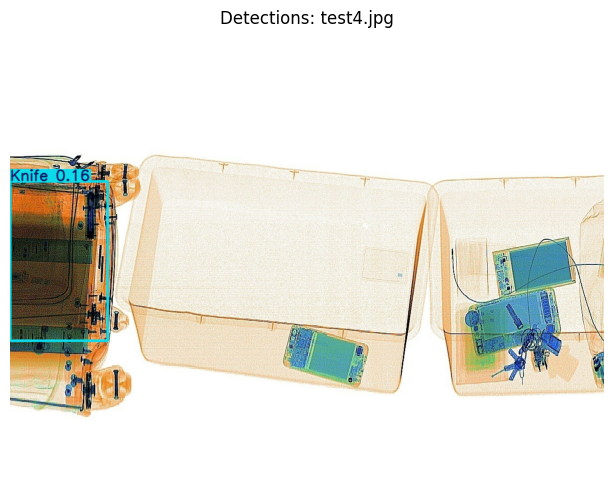


0: 640x416 1 Gun, 1 Knife, 38.5ms
Speed: 2.7ms preprocess, 38.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 416)


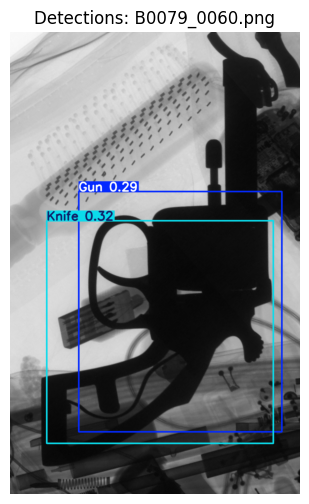


0: 384x640 (no detections), 32.2ms
Speed: 1.6ms preprocess, 32.2ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


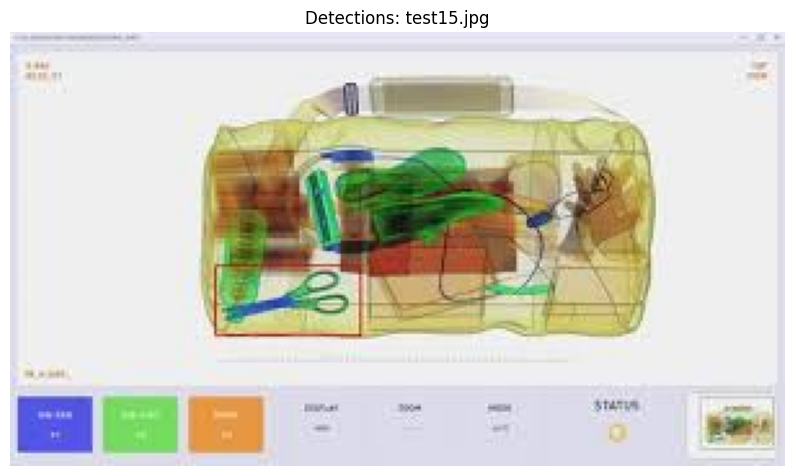


0: 640x576 1 Knife, 6.7ms
Speed: 2.6ms preprocess, 6.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


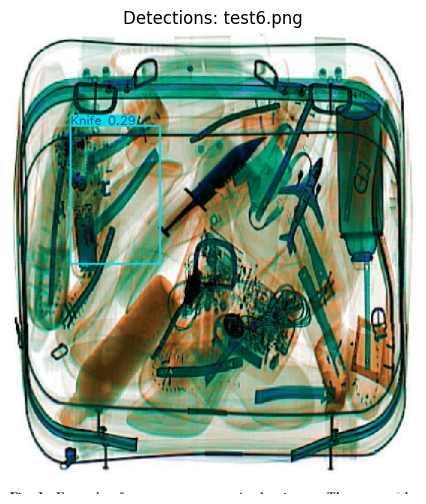

In [17]:
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images
#model1=YOLO('/kaggle/working/runs/detect/train/weights/best.pt')
# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model1(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()


## hyperparameter tuning 

## Model2

In [ ]:
from ultralytics import YOLO

model2 = YOLO("yolov8n.pt")  # Load pre-trained model
model2.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=60, batch=16)

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train3/confusion_matrix.png', width=700)


In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train3/F1_curve.png', width=700)


In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train3/P_curve.png', width=700)


In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train3/R_curve.png', width=700)


In [ ]:
model2.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train32/confusion_matrix.png', width=700)


In [ ]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model2(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()


In [ ]:
import os
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images

# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model2(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()


## Model3

In [18]:
from ultralytics import YOLO

model3 = YOLO("yolov8n.pt")  # Load pre-trained model
results3=model3.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=70, batch=16)

Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/sixray/sixray_v3/data.yaml, epochs=70, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning /kaggle/input/sixray/sixray_v3/train/labels... 11638 images, 115 backgrounds, 0 corrupt: 100%|██████████| 11638/11638 [00:23<00:00, 505.28it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/sixray/sixray_v3/valid/labels... 1662 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1662/1662 [00:03<00:00, 500.80it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train3
Starting training for 70 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/70      2.24G      1.864      3.322      1.764         20        640: 100%|██████████| 728/728 [02:19<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.36it/s]


                   all       1662       3176      0.451      0.414      0.397      0.192

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/70      3.16G      1.761      2.435      1.658         15        640: 100%|██████████| 728/728 [02:14<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.60it/s]


                   all       1662       3176      0.553      0.443      0.471      0.233

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/70      3.17G      1.784      2.228      1.701         23        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.63it/s]


                   all       1662       3176      0.403       0.29      0.293      0.135

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/70      3.17G      1.802      2.085      1.739         17        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]


                   all       1662       3176      0.574       0.49      0.534      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/70      3.17G      1.731        1.9      1.704         28        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]


                   all       1662       3176      0.622      0.519      0.564      0.303

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/70      3.17G      1.679      1.782       1.67         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.81it/s]


                   all       1662       3176      0.727      0.581      0.658       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/70      3.17G      1.629      1.678      1.635         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]


                   all       1662       3176      0.674      0.578       0.64      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/70      3.17G      1.597      1.615      1.609         19        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]


                   all       1662       3176       0.66      0.597      0.641      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/70      3.17G      1.566      1.559      1.591         39        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.83it/s]


                   all       1662       3176      0.769       0.62       0.71      0.414

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/70      3.17G      1.537      1.494      1.565         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]


                   all       1662       3176      0.767      0.624      0.724      0.425

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/70      3.17G      1.518      1.458      1.549         15        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]


                   all       1662       3176      0.789      0.643       0.74      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/70      3.17G      1.489      1.414      1.522         23        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]


                   all       1662       3176      0.799      0.647      0.748      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/70      3.17G      1.479      1.385      1.511         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.805      0.664      0.764       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/70      3.17G      1.453      1.359      1.497         22        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]


                   all       1662       3176      0.797       0.67      0.765      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/70      3.17G      1.439      1.325      1.481         15        640: 100%|██████████| 728/728 [02:11<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.02it/s]


                   all       1662       3176      0.831      0.671       0.78      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/70      3.17G       1.42        1.3      1.468         16        640: 100%|██████████| 728/728 [02:11<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.08it/s]

                   all       1662       3176      0.797      0.703      0.785      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/70      3.17G      1.413      1.276      1.467         28        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.04it/s]


                   all       1662       3176      0.807        0.7      0.782      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/70      3.17G      1.387       1.25      1.447         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]

                   all       1662       3176      0.842      0.706      0.808      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/70      3.17G      1.392      1.252      1.453         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]


                   all       1662       3176      0.821       0.73      0.808       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/70      3.17G      1.373       1.22      1.441         27        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]


                   all       1662       3176      0.843      0.703      0.818      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/70      3.17G      1.358      1.207      1.425         26        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.97it/s]

                   all       1662       3176      0.842       0.74      0.829      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/70      3.17G      1.347      1.186      1.417         33        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]

                   all       1662       3176      0.848       0.72       0.82      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/70      3.17G      1.339      1.175      1.408         14        640: 100%|██████████| 728/728 [02:14<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:10<00:00,  4.83it/s]

                   all       1662       3176      0.869      0.727      0.829      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/70      3.17G      1.327      1.162      1.399         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.45it/s]


                   all       1662       3176       0.84      0.744      0.834       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/70      3.17G      1.316      1.131      1.393         21        640: 100%|██████████| 728/728 [02:14<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]

                   all       1662       3176      0.861      0.746      0.839      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/70      3.17G      1.308      1.129      1.386         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.80it/s]


                   all       1662       3176      0.871      0.741      0.847      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/70      3.17G      1.301      1.111      1.381         22        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.92it/s]


                   all       1662       3176      0.861       0.76      0.844      0.566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/70      3.17G      1.288      1.097      1.369         34        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.86it/s]

                   all       1662       3176       0.88      0.758      0.851      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/70      3.17G      1.282      1.095      1.367         16        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.85it/s]

                   all       1662       3176      0.894      0.761      0.859      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/70      3.17G      1.277      1.083      1.365         21        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.02it/s]

                   all       1662       3176      0.867      0.777      0.857       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/70      3.17G      1.253      1.057      1.343         24        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.03it/s]

                   all       1662       3176      0.872      0.769      0.856      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/70      3.17G       1.25      1.055      1.342         31        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.90it/s]

                   all       1662       3176      0.887      0.775      0.863      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/70      3.17G      1.242      1.032      1.332         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.866      0.779       0.86      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/70      3.17G      1.242      1.031      1.332         23        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]

                   all       1662       3176      0.891      0.762      0.864      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/70      3.17G      1.236      1.028      1.329         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.13it/s]


                   all       1662       3176      0.883      0.778      0.865      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/70      3.17G      1.226      1.024      1.327         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.97it/s]

                   all       1662       3176      0.896      0.777      0.874      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/70      3.17G      1.214     0.9995      1.313         26        640: 100%|██████████| 728/728 [02:14<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.91it/s]


                   all       1662       3176       0.89      0.781      0.873        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/70      3.17G      1.214      1.003      1.313         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.15it/s]

                   all       1662       3176      0.877      0.785      0.872      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/70      3.17G      1.198     0.9777      1.302         21        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.899      0.782      0.877      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/70      3.17G      1.199     0.9827      1.307         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.882      0.798      0.877      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/70      3.17G      1.185     0.9598      1.291         14        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.16it/s]

                   all       1662       3176      0.904       0.78      0.878      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/70      3.17G      1.184     0.9572      1.289         31        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.92it/s]

                   all       1662       3176        0.9      0.797      0.883      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/70      3.17G      1.169     0.9441      1.278         21        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.65it/s]

                   all       1662       3176      0.912      0.788      0.884      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/70      3.17G       1.17     0.9435      1.283         21        640: 100%|██████████| 728/728 [02:11<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.64it/s]

                   all       1662       3176      0.893      0.798       0.88      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/70      3.17G      1.159      0.938      1.281         21        640: 100%|██████████| 728/728 [02:11<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.95it/s]

                   all       1662       3176      0.902      0.805      0.887      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/70      3.17G      1.152      0.924      1.268         16        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.99it/s]

                   all       1662       3176      0.897      0.799      0.885      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/70      3.17G      1.141     0.9083       1.26         14        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.14it/s]

                   all       1662       3176      0.887      0.808      0.884      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/70      3.17G      1.138     0.9108      1.262          9        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]

                   all       1662       3176      0.896       0.81      0.886      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/70      3.17G      1.125     0.8934       1.25         34        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.17it/s]

                   all       1662       3176      0.916      0.795      0.886      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/70      3.17G      1.125     0.8913       1.25         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.05it/s]

                   all       1662       3176      0.905      0.802      0.891      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/70      3.17G      1.119     0.8856      1.246         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]

                   all       1662       3176      0.898      0.813       0.89      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/70      3.17G      1.103     0.8702      1.239         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.20it/s]

                   all       1662       3176      0.897      0.814      0.887      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/70      3.17G        1.1     0.8661      1.233          7        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.94it/s]

                   all       1662       3176      0.903      0.812      0.893      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/70      3.17G      1.102     0.8717      1.236         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]

                   all       1662       3176      0.894      0.826      0.891      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/70      3.17G      1.087      0.855       1.23         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176      0.914      0.816      0.895       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/70      3.17G      1.085     0.8524       1.22         23        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.17it/s]

                   all       1662       3176      0.911      0.817      0.899      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/70      3.17G      1.071     0.8376      1.219         22        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.09it/s]

                   all       1662       3176      0.921      0.808      0.895      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/70      3.17G       1.07     0.8334      1.213         37        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.18it/s]

                   all       1662       3176      0.905      0.823      0.894      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/70      3.17G      1.062     0.8291      1.213         17        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.902       0.83      0.898      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/70      3.17G      1.051     0.8145      1.204         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176       0.91      0.826      0.899      0.643


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/70      3.17G      0.929     0.6063      1.157         10        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.93it/s]

                   all       1662       3176      0.919      0.826      0.901      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/70      3.17G     0.9123     0.5925      1.151          9        640: 100%|██████████| 728/728 [02:10<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.70it/s]

                   all       1662       3176      0.914      0.827        0.9      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/70      3.17G     0.9007     0.5808       1.14          7        640: 100%|██████████| 728/728 [02:10<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.54it/s]

                   all       1662       3176      0.922      0.824      0.903      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/70      3.17G      0.889     0.5735      1.132         12        640: 100%|██████████| 728/728 [02:10<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.84it/s]

                   all       1662       3176      0.904      0.838      0.903      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/70      3.17G     0.8762     0.5601      1.125          8        640: 100%|██████████| 728/728 [02:10<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]

                   all       1662       3176      0.909      0.832      0.902       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/70      3.17G     0.8676      0.552      1.117         12        640: 100%|██████████| 728/728 [02:10<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.15it/s]

                   all       1662       3176      0.911      0.831      0.901       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/70      3.17G     0.8641     0.5522      1.113         19        640: 100%|██████████| 728/728 [02:10<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]

                   all       1662       3176      0.913      0.825      0.901       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/70      3.17G     0.8509     0.5444      1.108         12        640: 100%|██████████| 728/728 [02:11<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.94it/s]

                   all       1662       3176       0.91      0.827      0.901      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/70      3.17G     0.8428     0.5357      1.103         11        640: 100%|██████████| 728/728 [02:11<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.907       0.83      0.902      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/70      3.17G     0.8442     0.5378        1.1         10        640: 100%|██████████| 728/728 [02:10<00:00,  5.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]

                   all       1662       3176      0.913      0.828      0.901      0.653



70 epochs completed in 2.751 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.38it/s]


                   all       1662       3176      0.913      0.828      0.901      0.654
                   Gun        551        888      0.953      0.944      0.979      0.754
                 Knife        291        442      0.907      0.792      0.879      0.624
                Pliers        794       1110      0.929      0.828      0.924      0.672
              Scissors        178        206      0.871       0.82      0.871      0.597
                Wrench        392        530      0.903      0.755      0.854      0.621


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 1.7ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train3


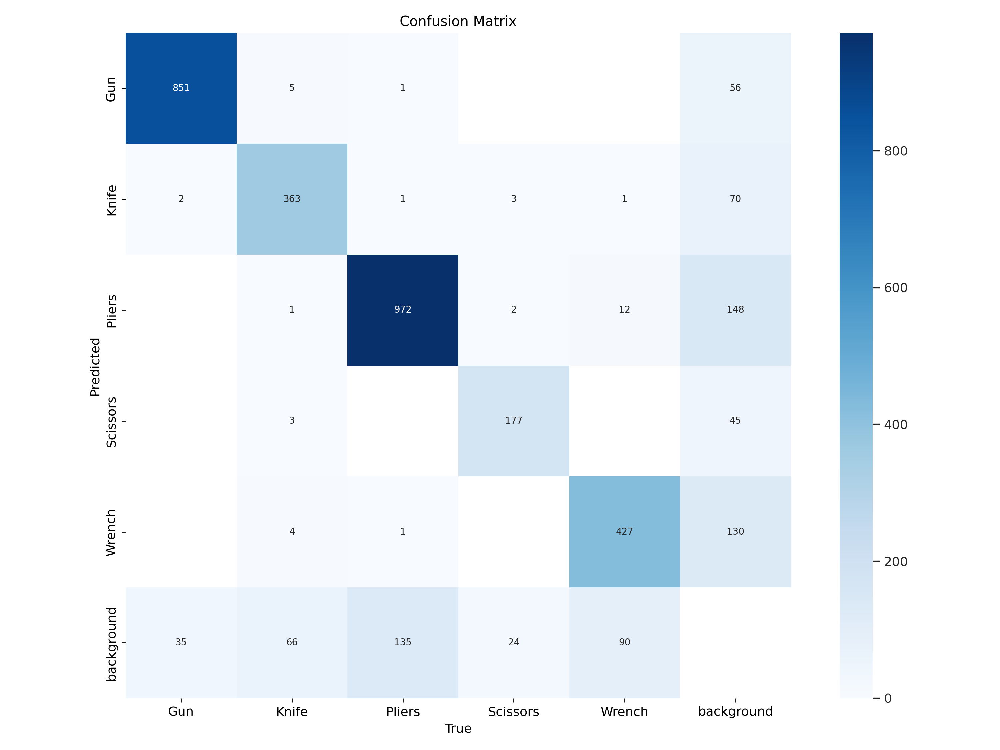

In [19]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train4/confusion_matrix.png', width=700)


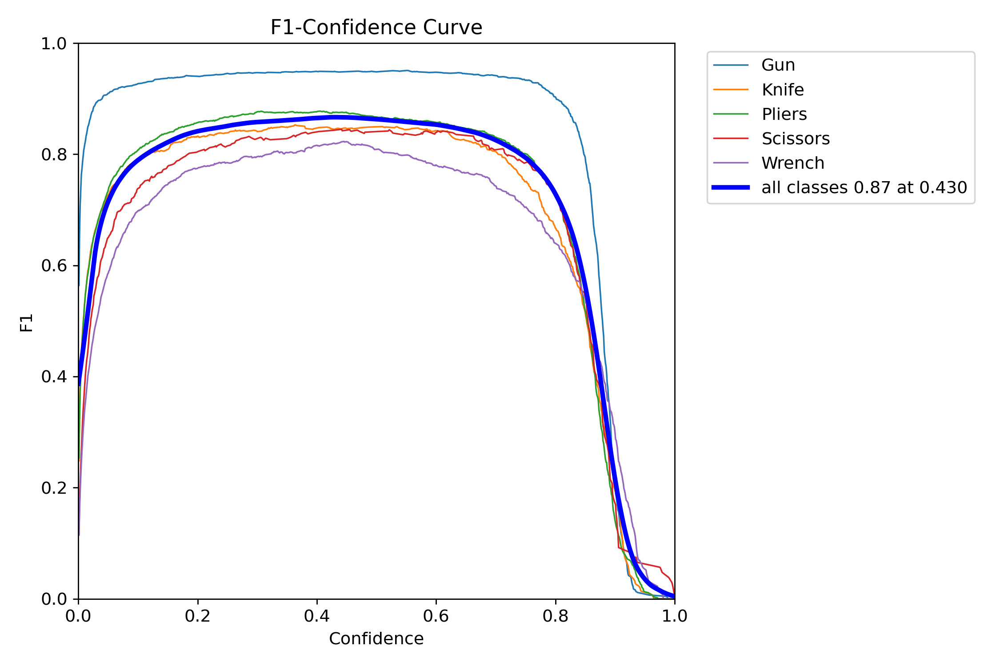

In [20]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train4/F1_curve.png', width=700)


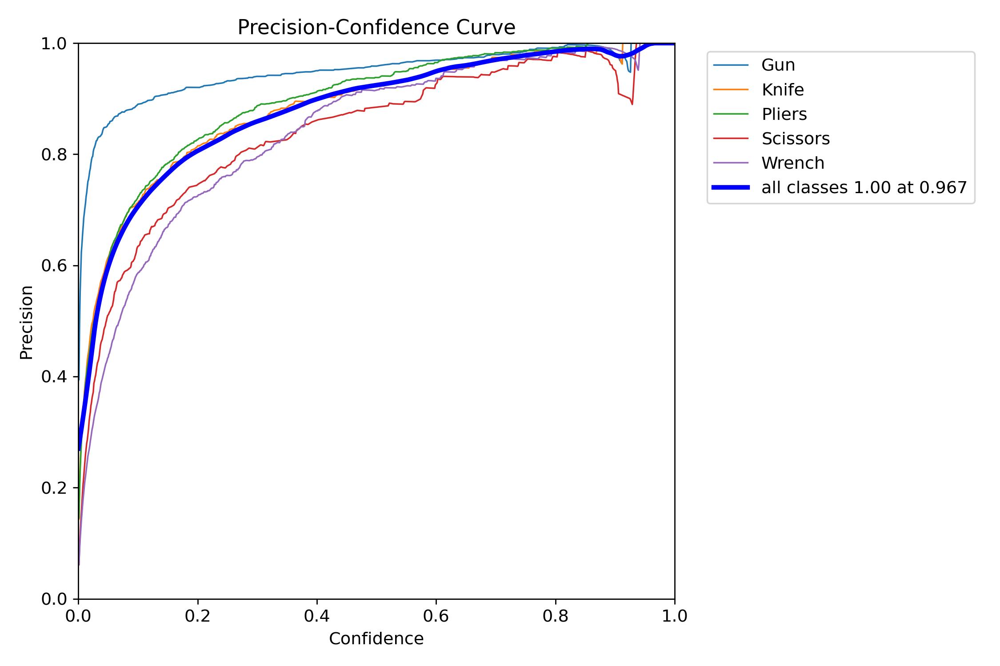

In [21]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train4/P_curve.png', width=700)


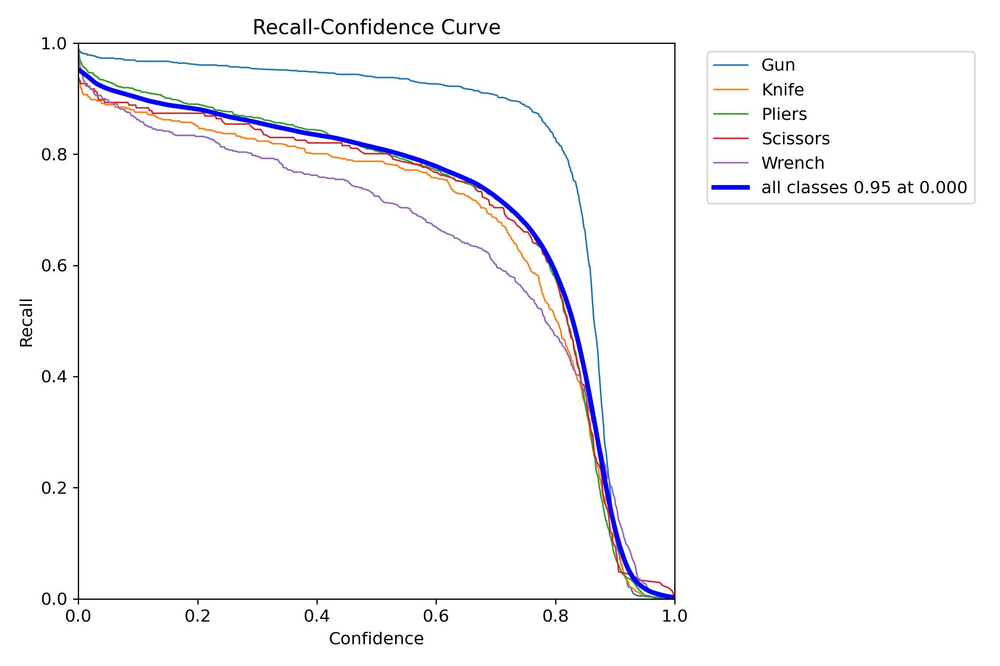

In [22]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train4/R_curve.png', width=700)


In [23]:
model3.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/sixray/sixray_v3/test/labels... 831 images, 2 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:01<00:00, 438.81it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:05<00:00,  8.69it/s]


                   all        831       1593      0.917      0.833      0.899      0.658
                   Gun        288        474      0.979      0.967      0.986      0.783
                 Knife        111        169      0.887      0.781      0.866      0.593
                Pliers        387        524      0.923      0.836      0.919      0.686
              Scissors         97        120      0.918      0.833       0.88      0.609
                Wrench        214        306      0.879      0.748      0.842       0.62


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.3ms preprocess, 1.9ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train32


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d18e66fbc70>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

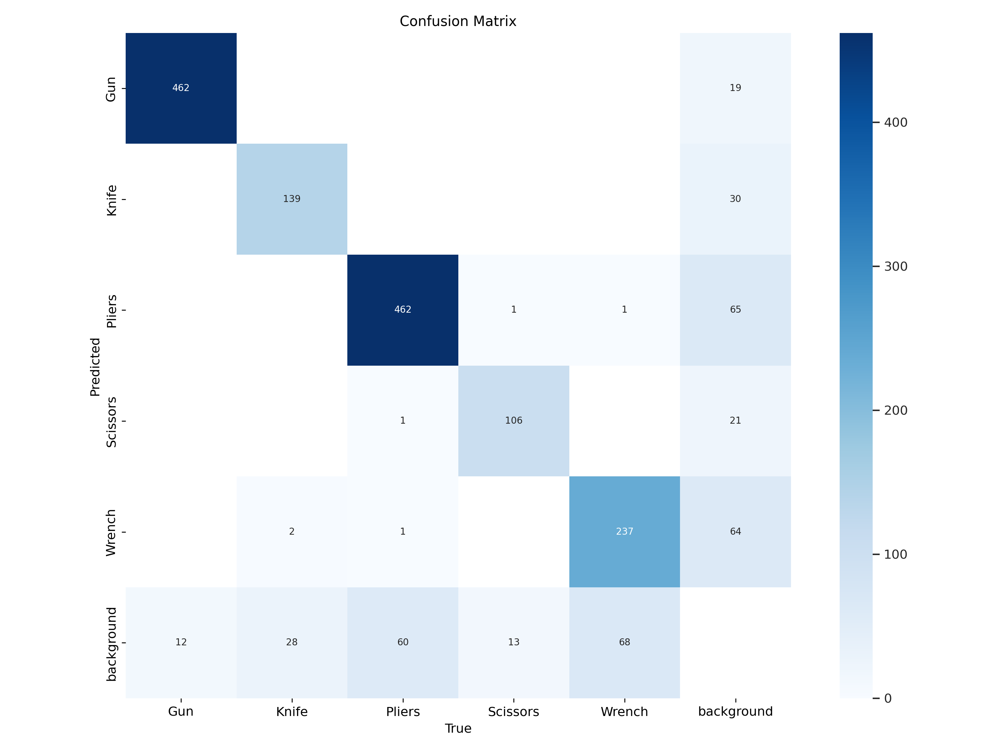

In [24]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train42/confusion_matrix.png', width=700)



image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P04090_jpg.rf.ce056770169b83e8da0eb5bcf90a7e2f.jpg: 640x352 1 Knife, 1 Wrench, 8.8ms
Speed: 1.5ms preprocess, 8.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 352)


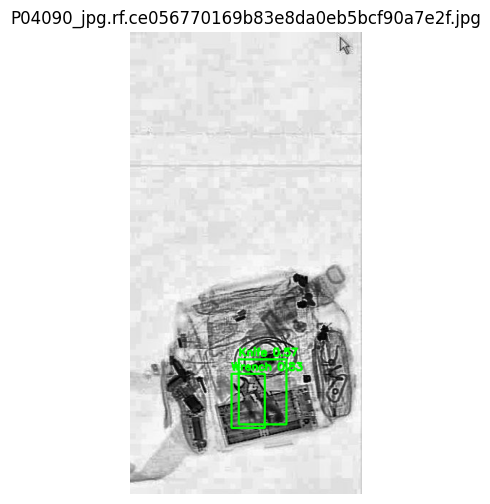


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00566_jpg.rf.f6f7244b34dc19538bbbcf6ee3a0afe9.jpg: 640x640 3 Knifes, 6.6ms
Speed: 4.2ms preprocess, 6.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


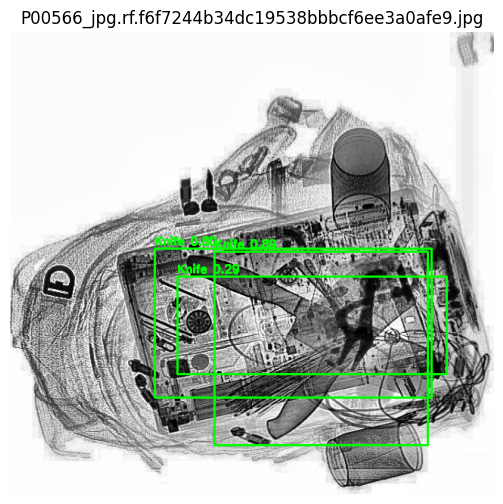


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P08192_jpg.rf.7d44114194ea0b181e8b6f624e3b43e5.jpg: 576x640 1 Scissors, 7.2ms
Speed: 1.6ms preprocess, 7.2ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


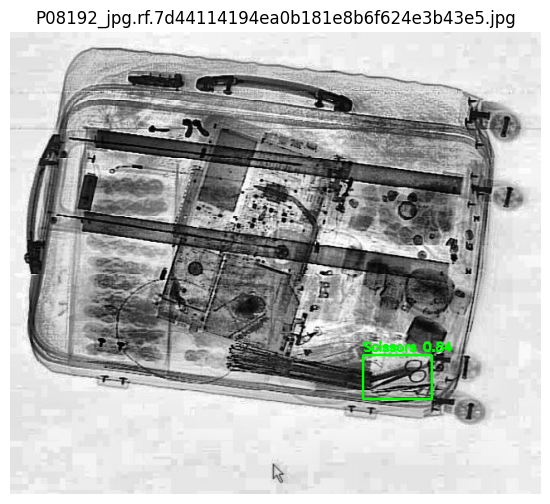


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00937_jpg.rf.e5686c9d95f2bbe37f7481ad72b65af5.jpg: 640x608 2 Guns, 1 Wrench, 7.2ms
Speed: 1.5ms preprocess, 7.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 608)


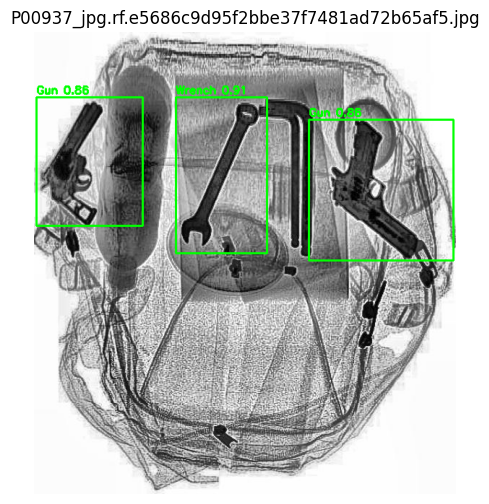


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P01417_jpg.rf.77884899d17be8dc4450d0cd49fc31c0.jpg: 640x640 2 Guns, 7.5ms
Speed: 1.5ms preprocess, 7.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


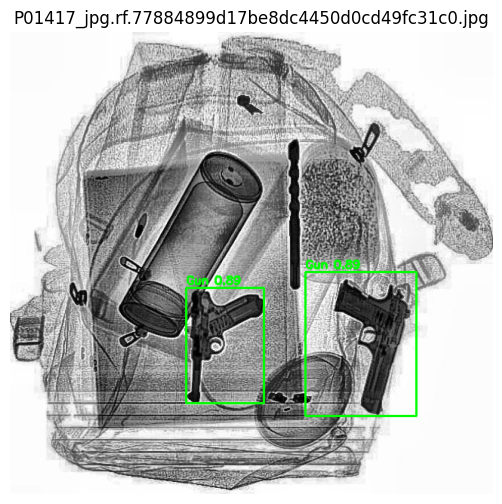

In [25]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model3(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()



0: 544x640 1 Pliers, 8.2ms
Speed: 2.8ms preprocess, 8.2ms inference, 1.2ms postprocess per image at shape (1, 3, 544, 640)


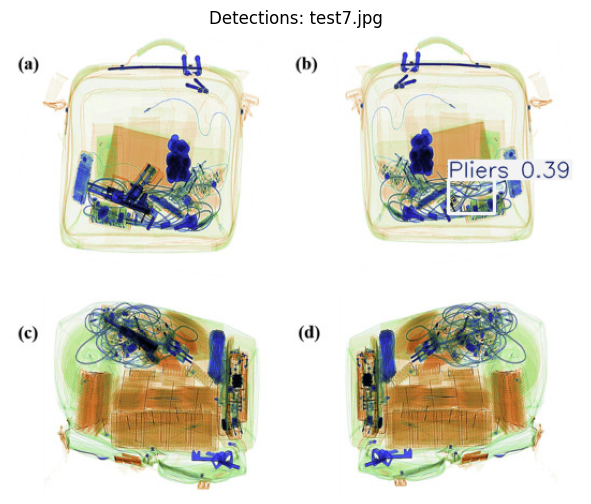


0: 640x640 1 Wrench, 8.7ms
Speed: 2.8ms preprocess, 8.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


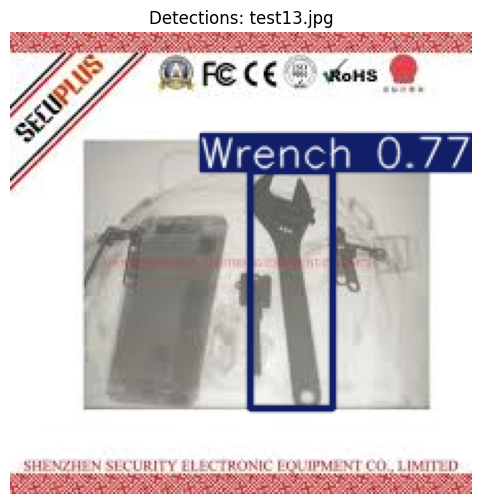


0: 512x640 1 Pliers, 7.7ms
Speed: 3.2ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


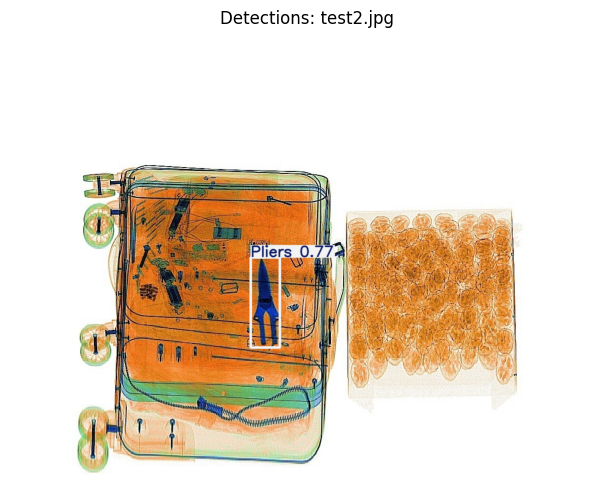


0: 576x640 3 Guns, 2 Knifes, 3 Plierss, 7.1ms
Speed: 3.0ms preprocess, 7.1ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


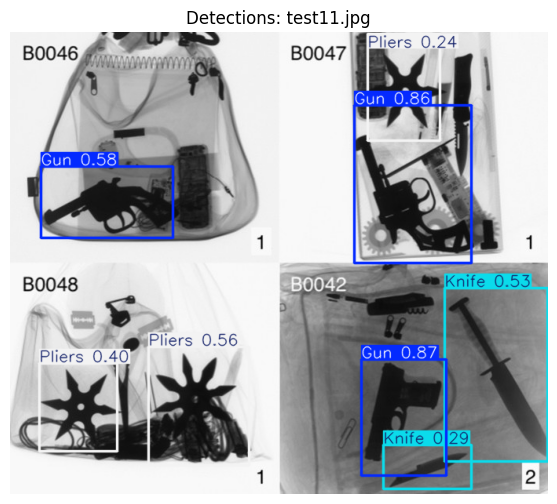


0: 608x640 1 Gun, 7.5ms
Speed: 2.9ms preprocess, 7.5ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)


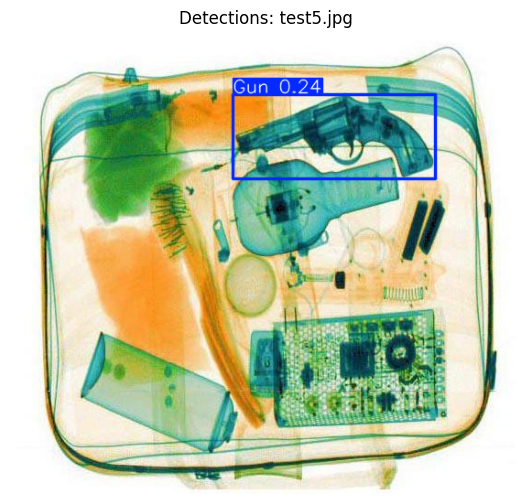


0: 448x640 2 Guns, 3 Knifes, 1 Pliers, 5 Scissorss, 7.6ms
Speed: 2.5ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


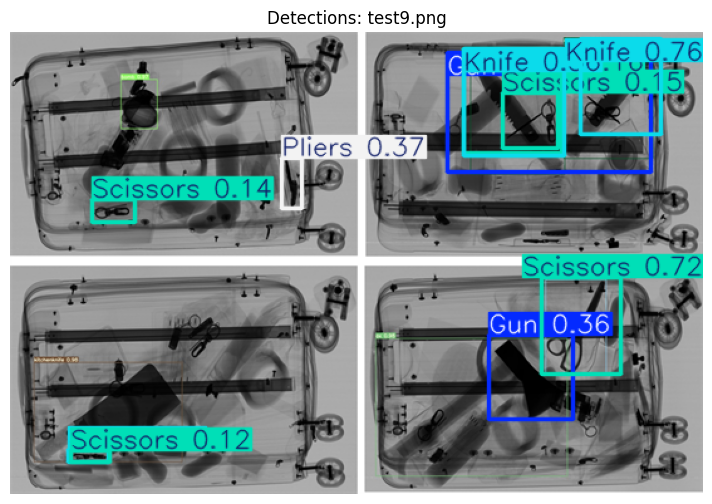


0: 512x640 (no detections), 6.8ms
Speed: 2.6ms preprocess, 6.8ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


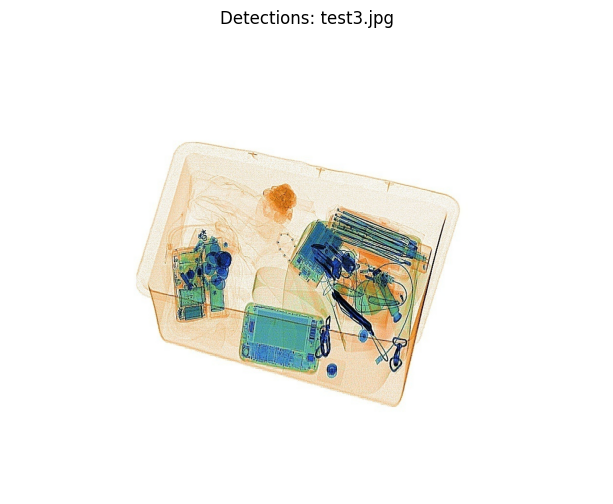


0: 640x576 2 Guns, 1 Knife, 3 Plierss, 1 Wrench, 8.3ms
Speed: 2.5ms preprocess, 8.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 576)


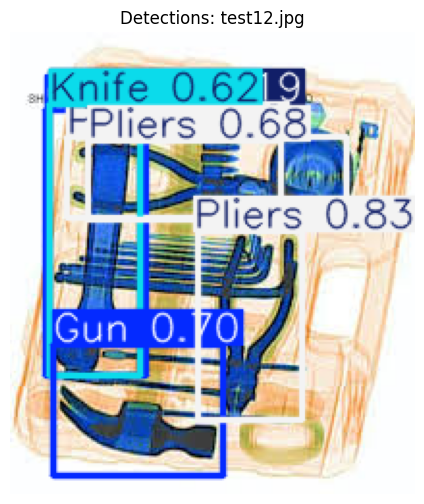


0: 288x640 3 Guns, 8.0ms
Speed: 2.1ms preprocess, 8.0ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


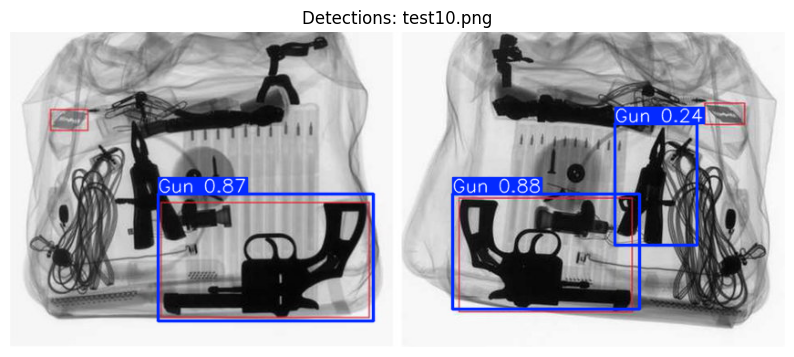


0: 224x640 (no detections), 8.5ms
Speed: 1.5ms preprocess, 8.5ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


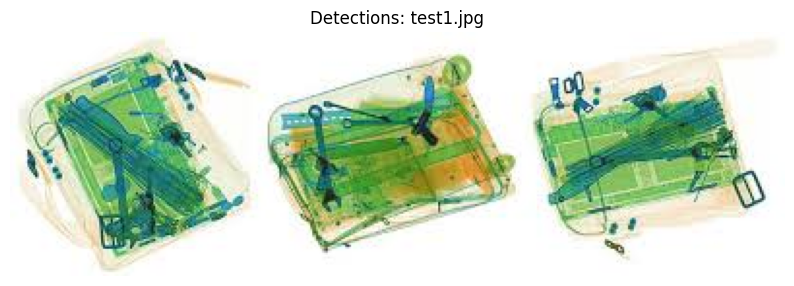


0: 512x640 (no detections), 7.1ms
Speed: 3.7ms preprocess, 7.1ms inference, 0.5ms postprocess per image at shape (1, 3, 512, 640)


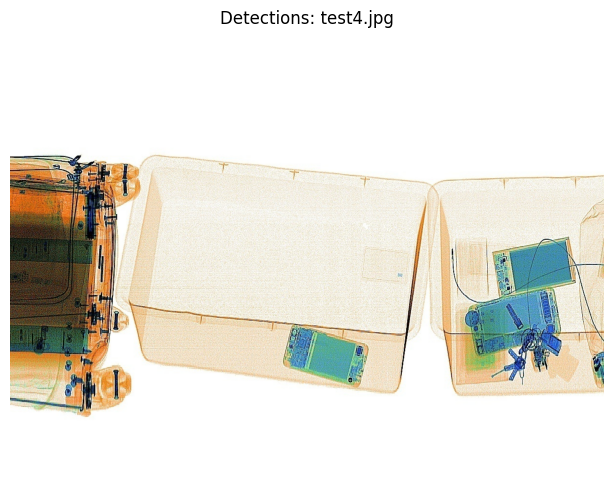


0: 640x416 (no detections), 7.6ms
Speed: 3.3ms preprocess, 7.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 416)


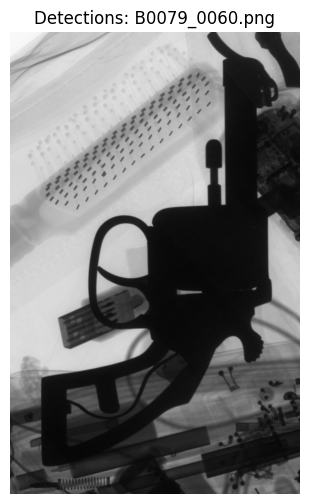


0: 384x640 1 Scissors, 8.0ms
Speed: 1.9ms preprocess, 8.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


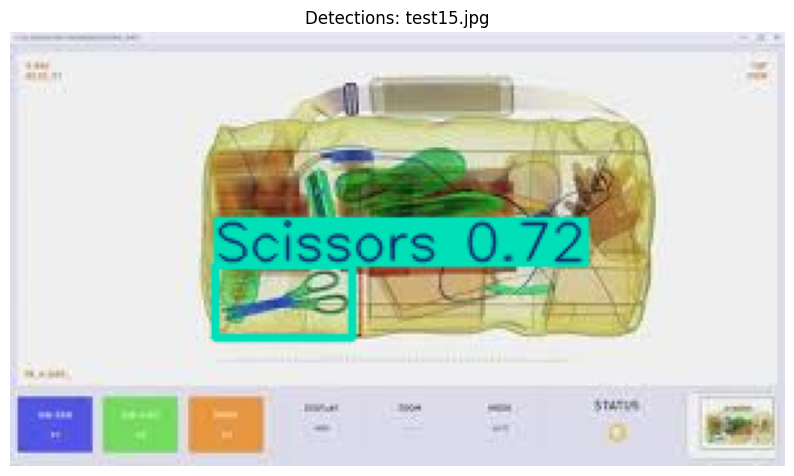


0: 640x576 1 Scissors, 1 Wrench, 6.9ms
Speed: 3.0ms preprocess, 6.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


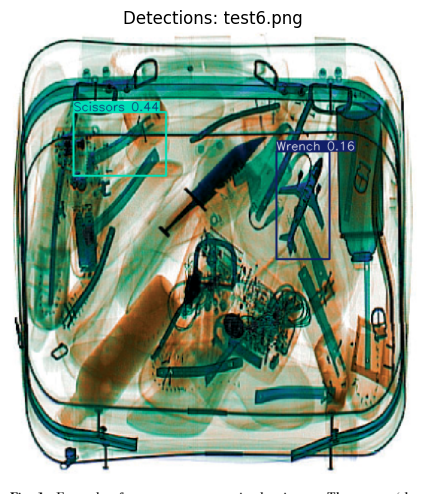

In [26]:
import os
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images

# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model3(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()


## Model4

In [27]:
from ultralytics import YOLO

model4 = YOLO("yolov8n.pt")  # Load pre-trained model
results4=model4.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=75, batch=16)

Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/sixray/sixray_v3/data.yaml, epochs=75, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning /kaggle/input/sixray/sixray_v3/train/labels... 11638 images, 115 backgrounds, 0 corrupt: 100%|██████████| 11638/11638 [00:22<00:00, 510.64it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/sixray/sixray_v3/valid/labels... 1662 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1662/1662 [00:03<00:00, 445.71it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train4
Starting training for 75 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/75       2.3G      1.864      3.322      1.764         20        640: 100%|██████████| 728/728 [02:18<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.38it/s]


                   all       1662       3176      0.451      0.414      0.397      0.192

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/75      3.22G      1.762      2.444      1.666         15        640: 100%|██████████| 728/728 [02:14<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.83it/s]


                   all       1662       3176      0.546      0.459      0.482      0.244

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/75      3.23G      1.784      2.231      1.702         23        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.83it/s]


                   all       1662       3176      0.531       0.42      0.433      0.202

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/75      3.23G      1.799      2.089      1.742         17        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.22it/s]


                   all       1662       3176      0.604      0.492       0.53      0.268

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/75      3.23G       1.73      1.908      1.704         28        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]


                   all       1662       3176       0.59      0.472      0.529      0.275

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/75      3.23G      1.685       1.78       1.67         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.89it/s]


                   all       1662       3176      0.702      0.529      0.613      0.327

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/75      3.23G      1.633       1.69      1.634         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.05it/s]


                   all       1662       3176       0.74      0.582      0.666      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/75      3.23G      1.599      1.618      1.613         19        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]


                   all       1662       3176      0.737      0.611      0.685      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/75      3.23G       1.57      1.565      1.585         39        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.00it/s]


                   all       1662       3176      0.699      0.609      0.677      0.397

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/75      3.23G       1.54      1.503      1.561         22        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.05it/s]


                   all       1662       3176      0.726      0.643      0.707      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/75      3.23G       1.52      1.465       1.55         15        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.14it/s]


                   all       1662       3176       0.78      0.645      0.737      0.447

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/75      3.23G      1.494      1.422      1.527         23        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.95it/s]


                   all       1662       3176      0.785      0.643       0.74      0.443

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/75      3.23G      1.477      1.387       1.51         21        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.21it/s]


                   all       1662       3176      0.784      0.669      0.755      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/75      3.23G      1.451      1.361      1.496         22        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.03it/s]


                   all       1662       3176      0.787      0.649      0.747      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/75      3.23G      1.436      1.325      1.479         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]


                   all       1662       3176        0.8      0.684      0.779       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/75      3.23G      1.426      1.305      1.471         16        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.18it/s]


                   all       1662       3176      0.828      0.679      0.786      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/75      3.23G      1.416      1.284      1.465         28        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]


                   all       1662       3176      0.809      0.692      0.797      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/75      3.23G      1.395      1.253      1.446         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176       0.81      0.716      0.805      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/75      3.23G       1.39      1.251      1.446         15        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.13it/s]


                   all       1662       3176      0.837      0.707      0.807      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/75      3.23G      1.375      1.223       1.44         27        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.99it/s]

                   all       1662       3176      0.845      0.702       0.81      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/75      3.23G      1.357       1.21       1.42         26        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.18it/s]

                   all       1662       3176      0.856      0.727      0.826      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/75      3.23G      1.351      1.193      1.416         33        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.16it/s]

                   all       1662       3176      0.848      0.726      0.822      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/75      3.23G      1.343      1.175      1.407         14        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.04it/s]

                   all       1662       3176      0.831      0.745      0.826      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/75      3.23G      1.335      1.163      1.402         26        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.18it/s]


                   all       1662       3176       0.86      0.733      0.835      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/75      3.23G      1.315      1.138      1.392         21        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.17it/s]

                   all       1662       3176       0.87      0.737      0.842       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/75      3.23G      1.308      1.132      1.387         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.98it/s]


                   all       1662       3176      0.859      0.739      0.836      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/75      3.23G      1.308      1.122      1.386         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.03it/s]

                   all       1662       3176      0.873      0.753      0.846      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/75      3.23G      1.288      1.099      1.369         34        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]


                   all       1662       3176      0.859      0.758      0.845      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/75      3.23G      1.291      1.101      1.371         16        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.99it/s]


                   all       1662       3176      0.876      0.747      0.847      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/75      3.23G      1.285      1.088      1.369         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]

                   all       1662       3176      0.866      0.771      0.858      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/75      3.23G      1.261      1.065      1.348         24        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.04it/s]

                   all       1662       3176      0.873      0.765      0.856      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/75      3.23G       1.26      1.066      1.349         31        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.95it/s]

                   all       1662       3176      0.895      0.761      0.867      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/75      3.23G      1.247      1.048      1.336         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.09it/s]

                   all       1662       3176      0.856      0.786      0.867      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/75      3.23G      1.248      1.042      1.338         23        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.91it/s]

                   all       1662       3176      0.882      0.781      0.867       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/75      3.23G      1.245      1.036      1.333         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.14it/s]

                   all       1662       3176      0.871      0.789      0.872      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/75      3.23G      1.233       1.03      1.328         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.05it/s]

                   all       1662       3176      0.888       0.79      0.872      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/75      3.23G      1.227      1.011       1.32         26        640: 100%|██████████| 728/728 [02:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.80it/s]

                   all       1662       3176       0.88      0.795      0.876      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/75      3.23G       1.22      1.011      1.319         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.21it/s]

                   all       1662       3176      0.865      0.804      0.873        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/75      3.23G      1.206     0.9881       1.31         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.14it/s]

                   all       1662       3176      0.887      0.787      0.877      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/75      3.23G      1.207      0.991      1.311         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.04it/s]

                   all       1662       3176      0.889      0.786       0.88      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/75      3.23G      1.197     0.9724      1.297         14        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176        0.9       0.79       0.88      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/75      3.23G      1.194      0.964      1.296         31        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.13it/s]

                   all       1662       3176      0.901       0.79      0.882      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/75      3.23G      1.179     0.9552      1.289         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.12it/s]

                   all       1662       3176      0.893      0.802      0.884      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/75      3.23G      1.184     0.9556       1.29         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.17it/s]

                   all       1662       3176      0.907      0.789      0.884      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/75      3.23G      1.172     0.9468      1.286         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.03it/s]

                   all       1662       3176      0.892      0.806      0.885       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/75      3.23G       1.16     0.9369      1.275         16        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.06it/s]

                   all       1662       3176      0.893      0.806      0.888      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/75      3.23G      1.154     0.9181      1.268         14        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.24it/s]

                   all       1662       3176      0.909      0.798      0.893      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/75      3.23G      1.151     0.9205       1.27          9        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.94it/s]

                   all       1662       3176      0.896      0.808       0.89      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/75      3.23G      1.138     0.9051      1.259         34        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.909      0.808      0.894      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/75      3.23G      1.137     0.9042      1.256         15        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.18it/s]

                   all       1662       3176      0.896      0.817      0.893      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/75      3.23G      1.133     0.8995      1.256         26        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.91it/s]

                   all       1662       3176      0.906      0.802      0.893      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/75      3.23G      1.115     0.8842      1.247         21        640: 100%|██████████| 728/728 [02:12<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176       0.89      0.814      0.892      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/75      3.23G      1.114      0.882      1.242          7        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.16it/s]

                   all       1662       3176      0.904       0.81      0.894      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/75      3.23G      1.117     0.8836      1.245         15        640: 100%|██████████| 728/728 [02:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.07it/s]

                   all       1662       3176      0.882      0.828      0.898      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/75      3.23G      1.101     0.8731       1.24         18        640: 100%|██████████| 728/728 [02:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.11it/s]

                   all       1662       3176      0.899      0.823      0.897      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/75      3.23G      1.102     0.8698      1.231         23        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.04it/s]

                   all       1662       3176      0.892      0.825      0.897      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/75      3.23G      1.088     0.8513       1.23         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.896      0.823      0.897       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/75      3.23G      1.085     0.8518       1.22         37        640: 100%|██████████| 728/728 [02:12<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.907      0.813      0.897      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/75      3.23G      1.081     0.8424      1.223         17        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.96it/s]

                   all       1662       3176      0.901      0.816      0.897      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/75      3.23G      1.068     0.8307      1.213         19        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.22it/s]

                   all       1662       3176      0.902      0.821      0.899      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/75      3.23G      1.064     0.8289      1.212         22        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.16it/s]

                   all       1662       3176      0.899      0.823      0.898      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/75      3.23G      1.056     0.8163      1.207         24        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.49it/s]

                   all       1662       3176      0.888      0.833      0.897      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/75      3.23G      1.059     0.8228      1.207         18        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.68it/s]

                   all       1662       3176      0.905      0.818      0.898      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/75      3.23G      1.049      0.812      1.199         17        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.58it/s]

                   all       1662       3176      0.888      0.836      0.899      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/75      3.23G       1.04     0.8045      1.195         30        640: 100%|██████████| 728/728 [02:12<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.57it/s]

                   all       1662       3176      0.888      0.832      0.899      0.649


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/75      3.23G     0.9169     0.5918      1.147         12        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.49it/s]

                   all       1662       3176      0.893      0.835        0.9       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/75      3.23G     0.8989     0.5739      1.137         19        640: 100%|██████████| 728/728 [02:11<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:10<00:00,  4.99it/s]

                   all       1662       3176      0.901      0.829      0.901      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/75      3.23G     0.8823     0.5648      1.126         12        640: 100%|██████████| 728/728 [02:11<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:09<00:00,  5.72it/s]

                   all       1662       3176      0.905      0.831      0.902      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/75      3.23G      0.878     0.5576      1.124         11        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.99it/s]

                   all       1662       3176      0.911      0.825      0.902      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/75      3.23G     0.8659     0.5512      1.117         10        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.91it/s]

                   all       1662       3176      0.913      0.828      0.902      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/75      3.23G     0.8587     0.5452      1.107         11        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.93it/s]

                   all       1662       3176      0.913       0.83      0.901      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/75      3.23G     0.8508     0.5395      1.106          8        640: 100%|██████████| 728/728 [02:12<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.01it/s]

                   all       1662       3176       0.91      0.829      0.901      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/75      3.23G     0.8432     0.5322      1.099          8        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.86it/s]

                   all       1662       3176      0.915      0.827      0.901      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/75      3.23G     0.8377     0.5308      1.095         17        640: 100%|██████████| 728/728 [02:11<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.10it/s]

                   all       1662       3176      0.911      0.831        0.9      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/75      3.23G     0.8291     0.5256      1.093         10        640: 100%|██████████| 728/728 [02:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  6.02it/s]

                   all       1662       3176      0.911      0.831      0.902      0.658



75 epochs completed in 2.947 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 6.2MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:10<00:00,  5.16it/s]


                   all       1662       3176      0.911       0.83      0.902      0.658
                   Gun        551        888      0.956      0.938      0.977      0.757
                 Knife        291        442      0.901      0.801      0.869      0.626
                Pliers        794       1110      0.936      0.834      0.926      0.669
              Scissors        178        206      0.876       0.83      0.885      0.617
                Wrench        392        530      0.886      0.749       0.85      0.623


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train4


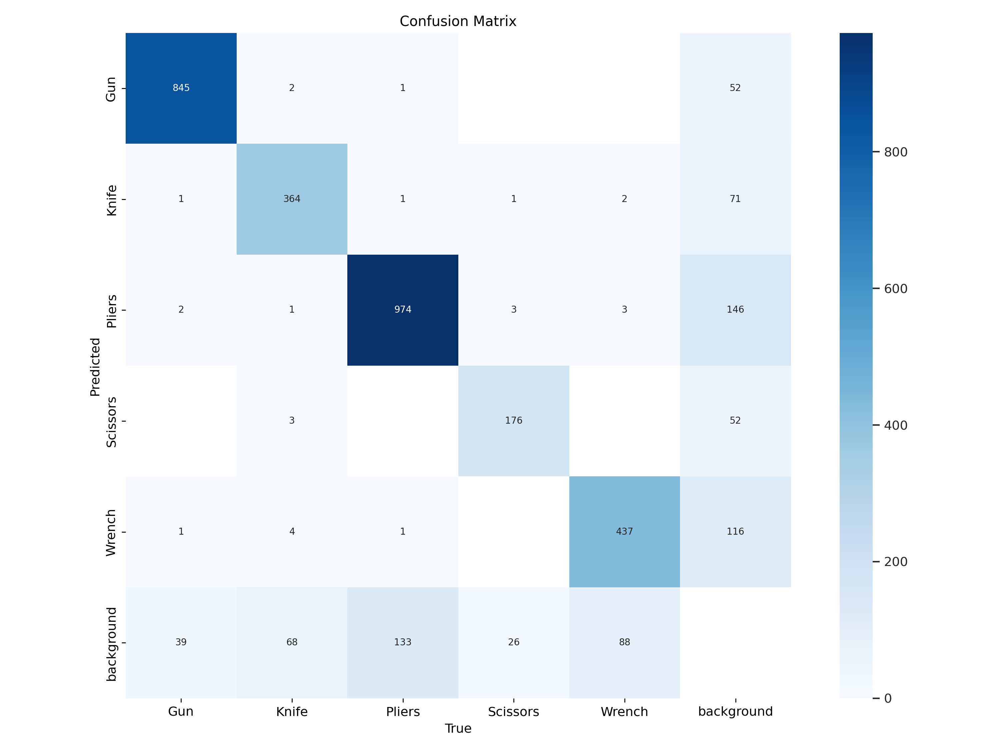

In [28]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train5/confusion_matrix.png', width=700)


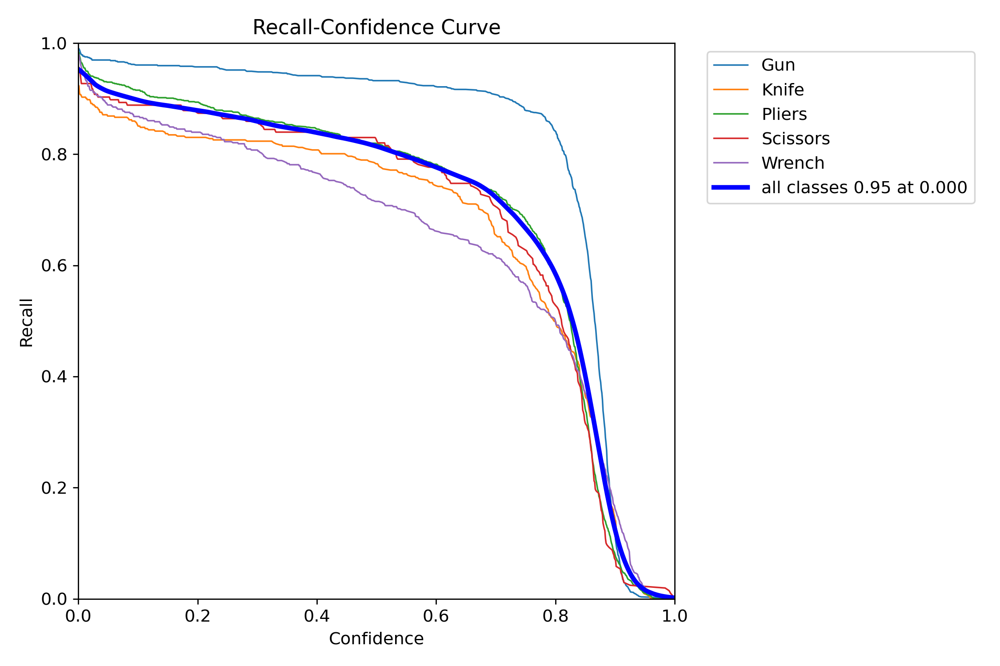

In [29]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train5/R_curve.png', width=700)


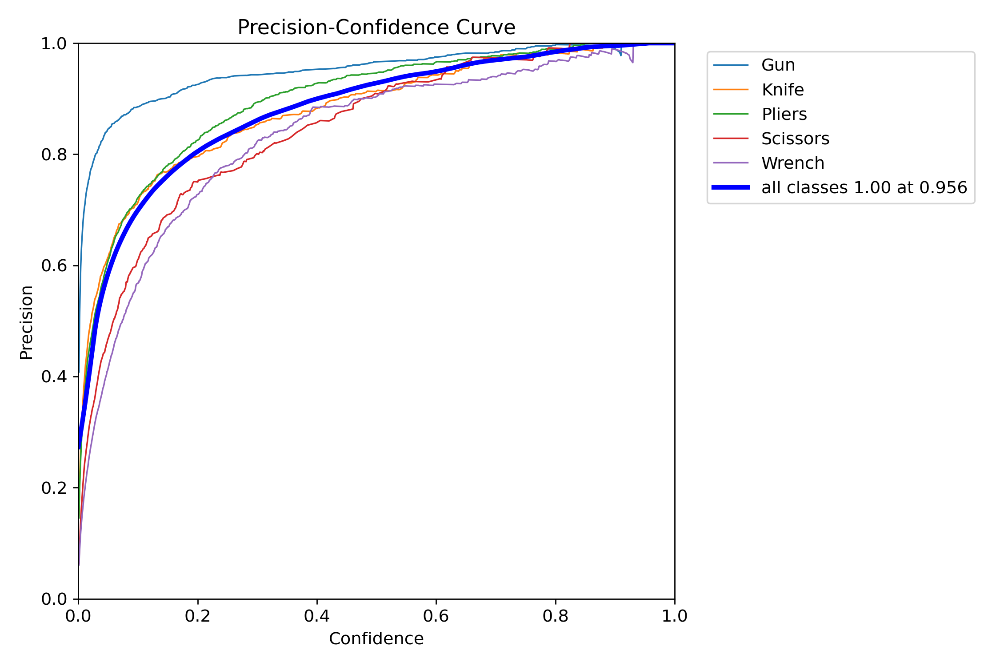

In [30]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train5/P_curve.png', width=700)


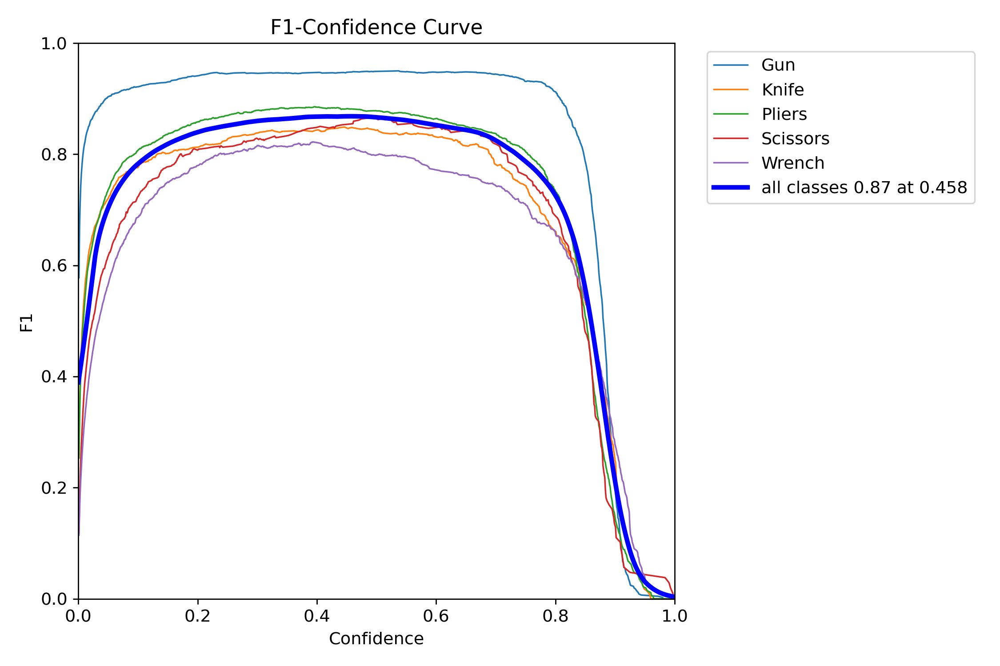

In [31]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train5/F1_curve.png', width=700)


In [32]:
model4.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/sixray/sixray_v3/test/labels... 831 images, 2 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:01<00:00, 443.83it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:05<00:00,  8.91it/s]


                   all        831       1593      0.922      0.818      0.899      0.659
                   Gun        288        474      0.985      0.961      0.984      0.775
                 Knife        111        169      0.874      0.734      0.855        0.6
                Pliers        387        524      0.934      0.838      0.922      0.687
              Scissors         97        120      0.938      0.842      0.889      0.617
                Wrench        214        306      0.879      0.716      0.845      0.616


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train42


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1902382110>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

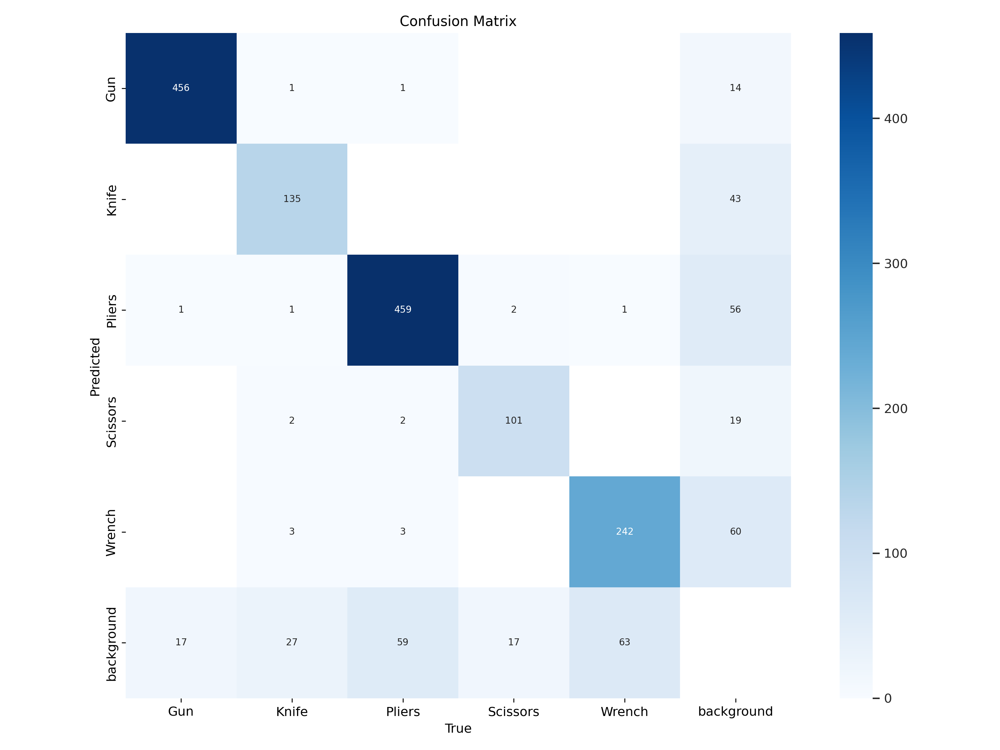

In [33]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train52/confusion_matrix.png', width=700)



image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P04090_jpg.rf.ce056770169b83e8da0eb5bcf90a7e2f.jpg: 640x352 1 Knife, 1 Wrench, 8.1ms
Speed: 2.2ms preprocess, 8.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 352)


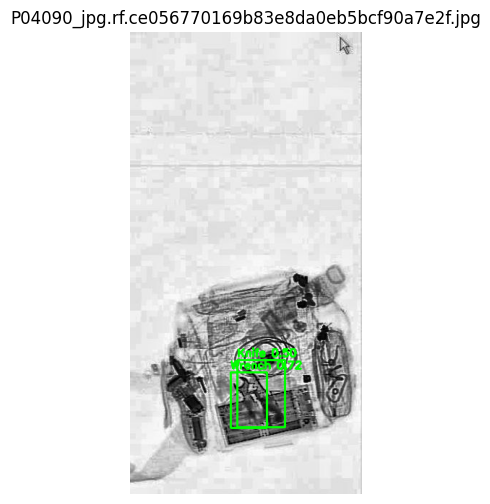


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00566_jpg.rf.f6f7244b34dc19538bbbcf6ee3a0afe9.jpg: 640x640 2 Knifes, 6.8ms
Speed: 4.2ms preprocess, 6.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


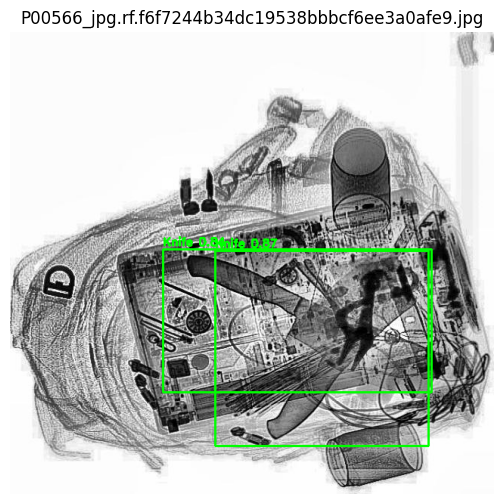


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P08192_jpg.rf.7d44114194ea0b181e8b6f624e3b43e5.jpg: 576x640 1 Scissors, 7.5ms
Speed: 3.9ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)


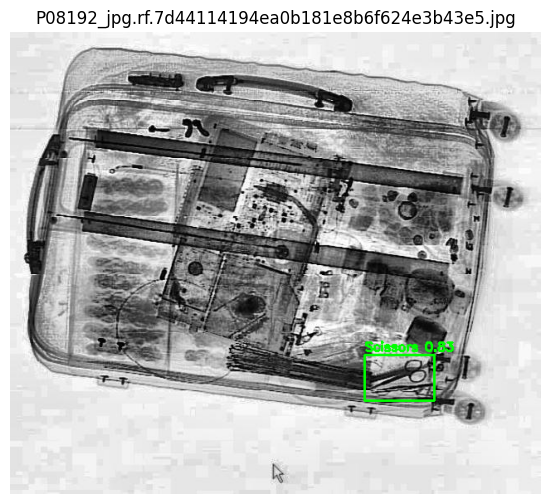


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00937_jpg.rf.e5686c9d95f2bbe37f7481ad72b65af5.jpg: 640x608 2 Guns, 1 Wrench, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 608)


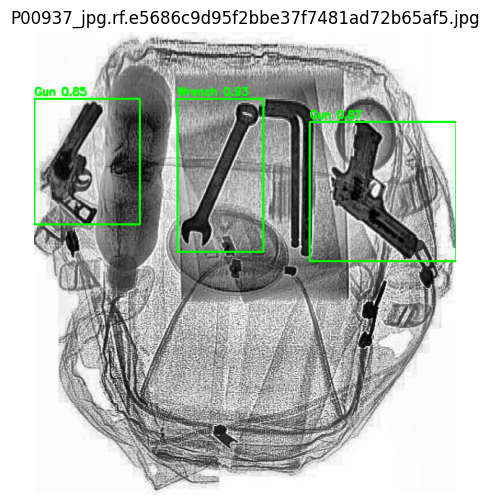


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P01417_jpg.rf.77884899d17be8dc4450d0cd49fc31c0.jpg: 640x640 2 Guns, 7.5ms
Speed: 1.7ms preprocess, 7.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


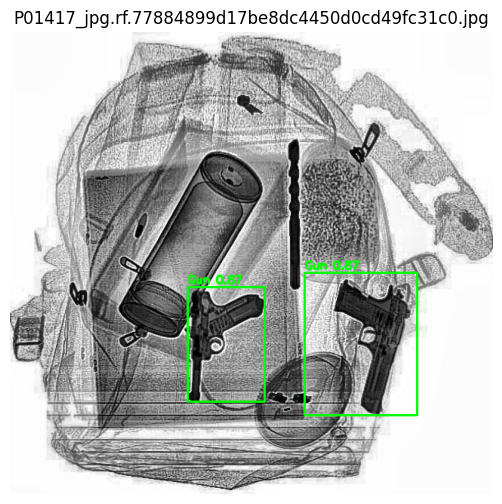

In [34]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model4(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()



0: 544x640 1 Gun, 1 Pliers, 9.6ms
Speed: 2.6ms preprocess, 9.6ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)


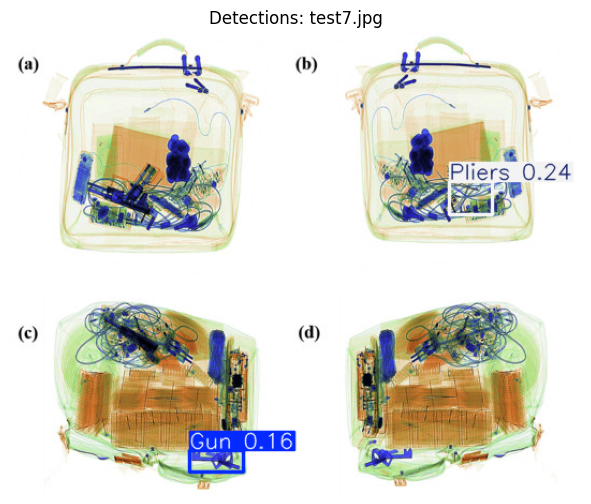


0: 640x640 2 Knifes, 1 Wrench, 7.0ms
Speed: 2.8ms preprocess, 7.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


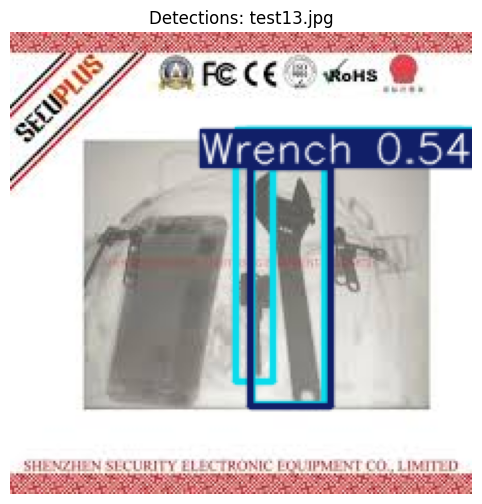


0: 512x640 1 Knife, 1 Pliers, 13.2ms
Speed: 3.5ms preprocess, 13.2ms inference, 3.3ms postprocess per image at shape (1, 3, 512, 640)


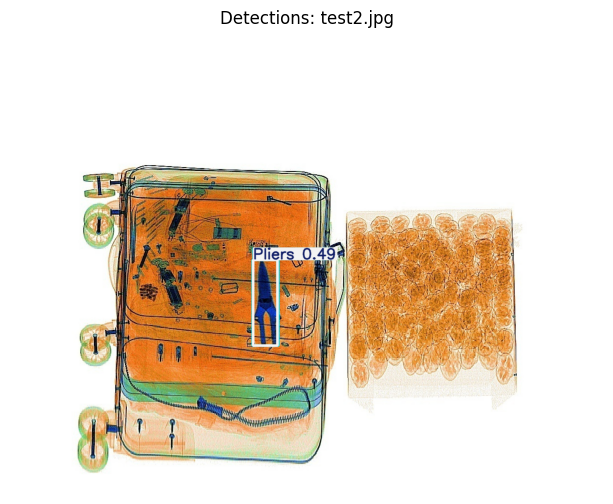


0: 576x640 3 Guns, 1 Knife, 1 Pliers, 7.7ms
Speed: 2.6ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


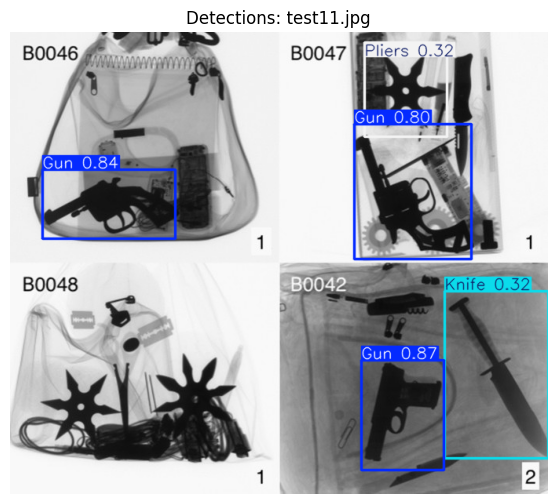


0: 608x640 2 Guns, 7.6ms
Speed: 2.9ms preprocess, 7.6ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)


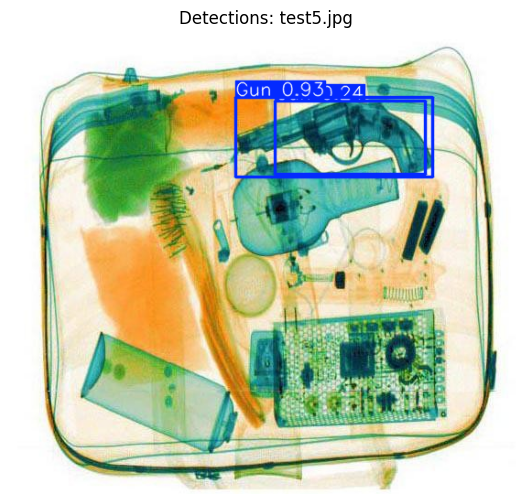


0: 448x640 2 Guns, 2 Knifes, 2 Scissorss, 8.2ms
Speed: 2.1ms preprocess, 8.2ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


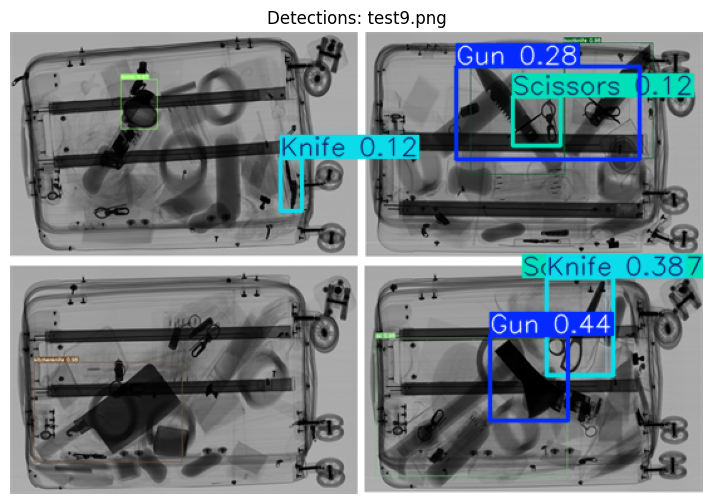


0: 512x640 1 Gun, 8.0ms
Speed: 2.9ms preprocess, 8.0ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


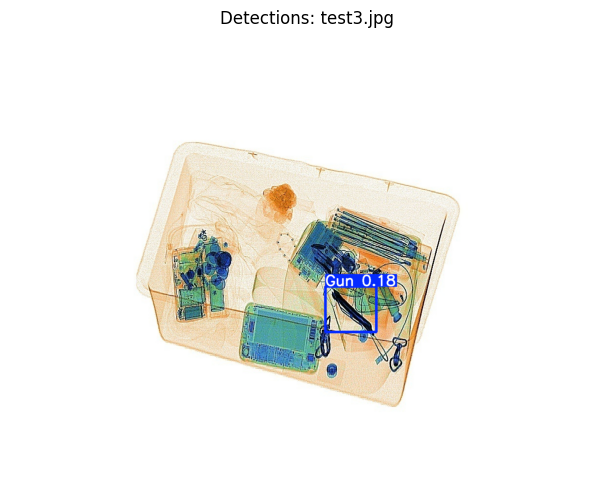


0: 640x576 1 Gun, 2 Plierss, 1 Wrench, 7.8ms
Speed: 2.3ms preprocess, 7.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


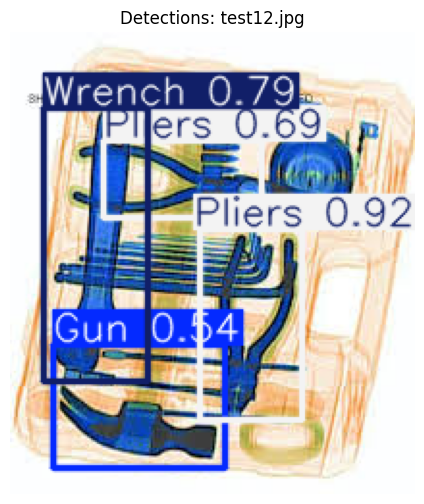


0: 288x640 2 Guns, 1 Pliers, 1 Scissors, 2 Wrenchs, 8.2ms
Speed: 1.9ms preprocess, 8.2ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


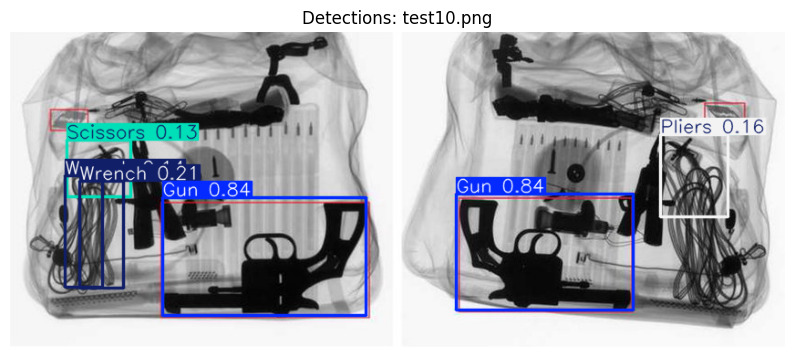


0: 224x640 2 Guns, 8.7ms
Speed: 1.6ms preprocess, 8.7ms inference, 1.3ms postprocess per image at shape (1, 3, 224, 640)


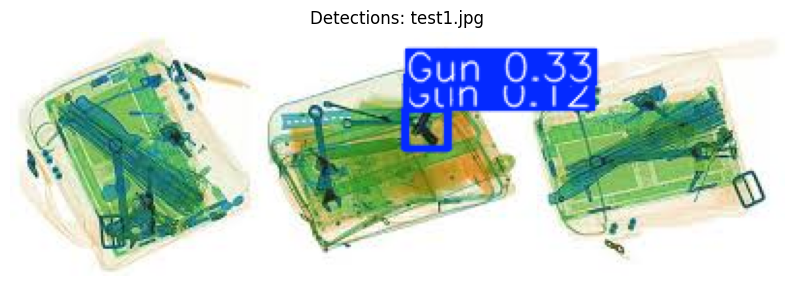


0: 512x640 (no detections), 7.1ms
Speed: 2.8ms preprocess, 7.1ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


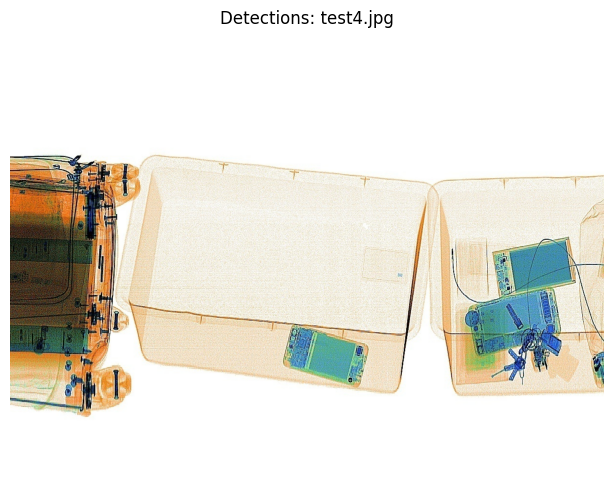


0: 640x416 2 Scissorss, 9.0ms
Speed: 2.4ms preprocess, 9.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 416)


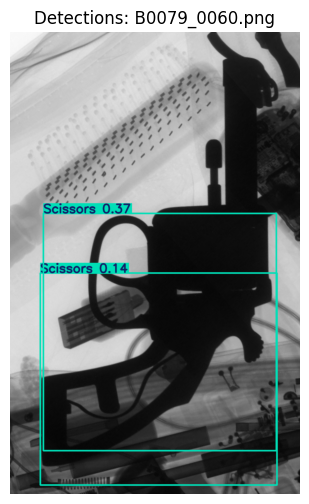


0: 384x640 1 Knife, 1 Scissors, 8.4ms
Speed: 2.0ms preprocess, 8.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


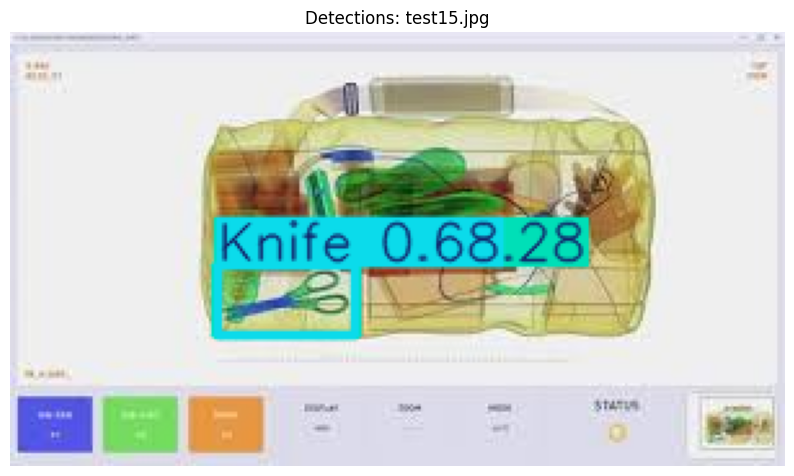


0: 640x576 2 Guns, 1 Wrench, 6.9ms
Speed: 5.0ms preprocess, 6.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


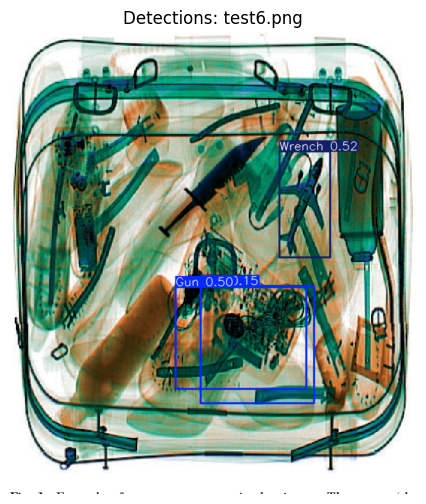

In [35]:
import os
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images

# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model4(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()


## Model 6

In [ ]:
from ultralytics import YOLO

model6 = YOLO("yolov8n.pt")  # Load pre-trained model
model6.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=80, batch=16)

In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train6/confusion_matrix.png', width=700)


In [ ]:
model6.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


In [ ]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train62/confusion_matrix.png', width=700)


## Model 7

In [36]:
from ultralytics import YOLO

model7 = YOLO("yolov8n.pt")  # Load pre-trained model
model7.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=50, batch=32)

Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/sixray/sixray_v3/data.yaml, epochs=50, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning /kaggle/input/sixray/sixray_v3/train/labels... 11638 images, 115 backgrounds, 0 corrupt: 100%|██████████| 11638/11638 [00:25<00:00, 454.58it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/sixray/sixray_v3/valid/labels... 1662 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1662/1662 [00:03<00:00, 437.69it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/valid is not writeable, cache not saved.
Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train5
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      3.99G      1.859      2.951      1.727         74        640: 100%|██████████| 364/364 [02:05<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.62it/s]


                   all       1662       3176      0.435      0.434      0.405      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      7.84G      1.752      2.104       1.67         62        640: 100%|██████████| 364/364 [01:58<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.96it/s]

                   all       1662       3176      0.528      0.476      0.469      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      7.84G      1.707      1.888      1.659         46        640: 100%|██████████| 364/364 [01:59<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.83it/s]


                   all       1662       3176      0.575      0.452      0.481      0.248

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      7.84G      1.696      1.813      1.657         64        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.06it/s]

                   all       1662       3176      0.631       0.52      0.556      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      7.84G      1.631      1.682      1.606         64        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.73it/s]

                   all       1662       3176      0.698      0.529      0.599       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      7.84G      1.583      1.584      1.577         74        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.04it/s]

                   all       1662       3176      0.679      0.571      0.639      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      7.84G      1.544      1.512      1.552         72        640: 100%|██████████| 364/364 [01:57<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.07it/s]

                   all       1662       3176      0.744       0.63      0.716      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      7.84G       1.51      1.443      1.529         68        640: 100%|██████████| 364/364 [01:59<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.753      0.641      0.727      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      7.84G       1.48      1.406      1.503         75        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.756      0.616      0.705      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      7.84G      1.463      1.367      1.491         79        640: 100%|██████████| 364/364 [01:59<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.12it/s]

                   all       1662       3176      0.809      0.641      0.754      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      7.84G      1.445      1.342      1.481         74        640: 100%|██████████| 364/364 [01:56<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.11it/s]

                   all       1662       3176       0.81      0.661      0.765      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      7.84G      1.417      1.291      1.459         92        640: 100%|██████████| 364/364 [01:58<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.06it/s]

                   all       1662       3176        0.8       0.66      0.754      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      7.84G       1.39      1.257      1.437         74        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.99it/s]

                   all       1662       3176      0.825      0.681      0.786      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      7.84G      1.381      1.235      1.432         71        640: 100%|██████████| 364/364 [01:59<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.84it/s]

                   all       1662       3176      0.829        0.7      0.796      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      7.84G      1.366      1.211      1.414         69        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.11it/s]

                   all       1662       3176      0.855      0.712      0.812      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      7.84G      1.339      1.175        1.4         68        640: 100%|██████████| 364/364 [01:59<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.03it/s]

                   all       1662       3176       0.82      0.707      0.801      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      7.84G       1.32      1.152      1.387         85        640: 100%|██████████| 364/364 [01:56<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.849      0.721      0.815      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      7.84G      1.316      1.135      1.382         79        640: 100%|██████████| 364/364 [01:57<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.75it/s]

                   all       1662       3176      0.857       0.73      0.828      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.84G      1.307      1.123      1.374         70        640: 100%|██████████| 364/364 [01:58<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.98it/s]

                   all       1662       3176      0.868      0.717      0.827      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      7.84G      1.287      1.106      1.365         76        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.10it/s]

                   all       1662       3176      0.847      0.743      0.837      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      7.84G      1.273      1.086      1.347         75        640: 100%|██████████| 364/364 [02:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.09it/s]

                   all       1662       3176      0.869      0.741      0.837      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.84G      1.265      1.073      1.345         71        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.91it/s]

                   all       1662       3176      0.865      0.738      0.837      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.84G      1.259      1.063      1.336         70        640: 100%|██████████| 364/364 [02:00<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.98it/s]

                   all       1662       3176      0.852      0.767      0.846      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      7.84G      1.242      1.037      1.324         89        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.95it/s]

                   all       1662       3176      0.856      0.766      0.849      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      7.84G      1.233      1.029       1.32         70        640: 100%|██████████| 364/364 [02:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.03it/s]

                   all       1662       3176      0.883      0.747      0.854      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.84G       1.22      1.013      1.305         65        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.88it/s]

                   all       1662       3176      0.873      0.761      0.855      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.84G      1.205     0.9926        1.3         72        640: 100%|██████████| 364/364 [01:59<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.04it/s]

                   all       1662       3176      0.888       0.77      0.866      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.84G      1.199     0.9805      1.294         82        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.08it/s]

                   all       1662       3176      0.891      0.769      0.867      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      7.84G      1.186     0.9698      1.284         68        640: 100%|██████████| 364/364 [01:59<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.69it/s]

                   all       1662       3176      0.894      0.772      0.868      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.84G      1.181     0.9681       1.28         85        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.875      0.778       0.87      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      7.84G      1.168     0.9506      1.274         93        640: 100%|██████████| 364/364 [01:57<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.69it/s]

                   all       1662       3176        0.9      0.773      0.875      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      7.84G      1.161     0.9353      1.267        121        640: 100%|██████████| 364/364 [01:58<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.99it/s]

                   all       1662       3176      0.877        0.8      0.878      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      7.84G      1.154     0.9257      1.262         81        640: 100%|██████████| 364/364 [01:57<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.19it/s]

                   all       1662       3176        0.9      0.786       0.88      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      7.84G      1.146     0.9117      1.256         78        640: 100%|██████████| 364/364 [01:59<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.08it/s]

                   all       1662       3176       0.87      0.814      0.883       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.84G      1.136     0.9079      1.248         88        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.01it/s]

                   all       1662       3176      0.894      0.795      0.884       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      7.84G      1.126     0.9022      1.249         66        640: 100%|██████████| 364/364 [02:09<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:10<00:00,  2.37it/s]

                   all       1662       3176      0.889      0.804      0.882      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      7.84G      1.115     0.8826      1.235         79        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.904      0.809      0.888      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      7.84G      1.108     0.8777      1.232         78        640: 100%|██████████| 364/364 [02:00<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.04it/s]

                   all       1662       3176      0.912      0.796       0.89       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      7.84G      1.102     0.8702      1.228         72        640: 100%|██████████| 364/364 [01:57<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.97it/s]

                   all       1662       3176      0.897      0.812       0.89      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      7.84G      1.093     0.8594      1.221         76        640: 100%|██████████| 364/364 [01:59<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.05it/s]

                   all       1662       3176      0.898      0.804      0.885      0.627


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      7.84G     0.9784      0.651      1.177         37        640: 100%|██████████| 364/364 [01:57<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.04it/s]

                   all       1662       3176      0.903      0.809      0.892      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      7.84G     0.9588     0.6362      1.168         42        640: 100%|██████████| 364/364 [01:57<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.83it/s]

                   all       1662       3176      0.909      0.809      0.895      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      7.84G     0.9345     0.6168      1.148         32        640: 100%|██████████| 364/364 [01:55<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.15it/s]

                   all       1662       3176      0.907      0.814      0.894      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      7.84G     0.9267     0.6113      1.142         40        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:09<00:00,  2.73it/s]

                   all       1662       3176       0.91      0.808      0.893      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      7.84G     0.9139     0.6018      1.132         31        640: 100%|██████████| 364/364 [01:58<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.01it/s]

                   all       1662       3176      0.924      0.805      0.896      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      7.84G     0.9029     0.5924      1.129         53        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.919      0.815      0.897      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      7.84G     0.8951     0.5799      1.123         39        640: 100%|██████████| 364/364 [01:58<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.07it/s]

                   all       1662       3176      0.899      0.825      0.897      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      7.84G     0.8843     0.5722      1.117         45        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.01it/s]

                   all       1662       3176      0.908       0.82      0.898      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      7.84G     0.8742     0.5686      1.111         40        640: 100%|██████████| 364/364 [01:58<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.98it/s]

                   all       1662       3176      0.915      0.821        0.9      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      7.84G     0.8677     0.5648      1.106         46        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.13it/s]

                   all       1662       3176      0.907      0.824        0.9      0.649



50 epochs completed in 1.769 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 6.2MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:10<00:00,  2.51it/s]


                   all       1662       3176      0.907      0.824        0.9      0.648
                   Gun        551        888      0.967      0.945       0.98      0.758
                 Knife        291        442      0.895      0.787      0.867      0.617
                Pliers        794       1110      0.915      0.837      0.921      0.652
              Scissors        178        206      0.871       0.82      0.889      0.606
                Wrench        392        530      0.885      0.728      0.841      0.608


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 1.7ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train5


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1833521de0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

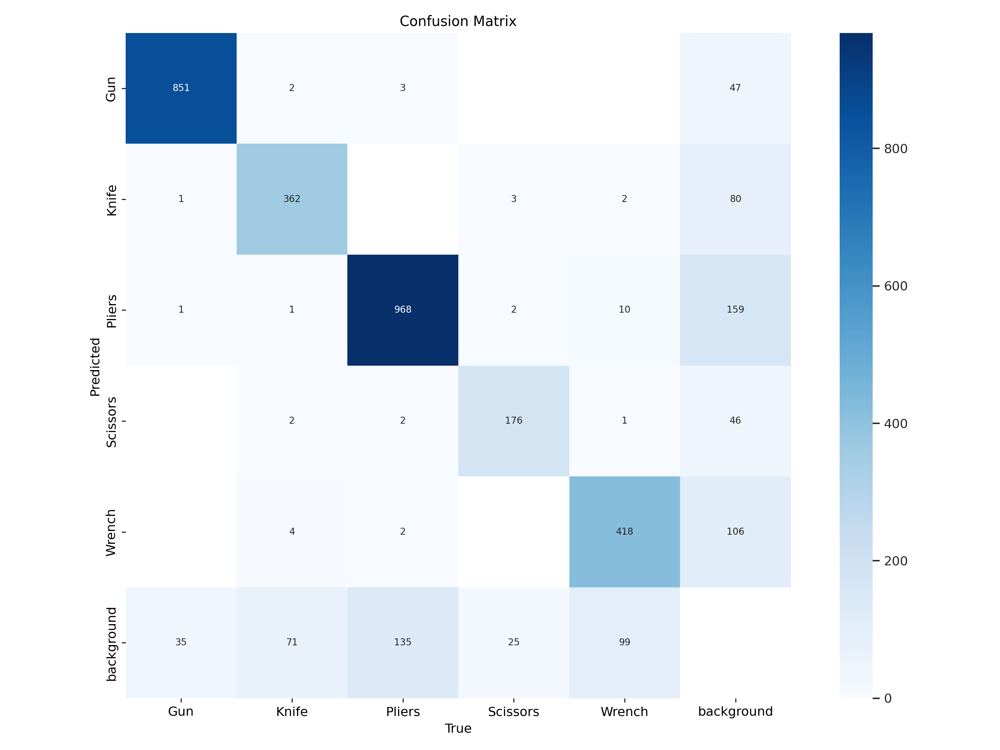

In [37]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train7/confusion_matrix.png', width=700)


In [38]:
model7.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


Ultralytics 8.3.100 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/sixray/sixray_v3/test/labels... 831 images, 2 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:02<00:00, 338.30it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:07<00:00,  3.55it/s]


                   all        831       1593      0.907      0.822      0.891      0.652
                   Gun        288        474      0.974      0.958      0.989      0.775
                 Knife        111        169      0.836      0.805       0.86        0.6
                Pliers        387        524      0.919      0.827      0.911       0.68
              Scissors         97        120      0.933      0.809      0.869      0.612
                Wrench        214        306      0.871      0.712      0.824      0.596


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.6ms preprocess, 2.6ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train52


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1902884ac0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

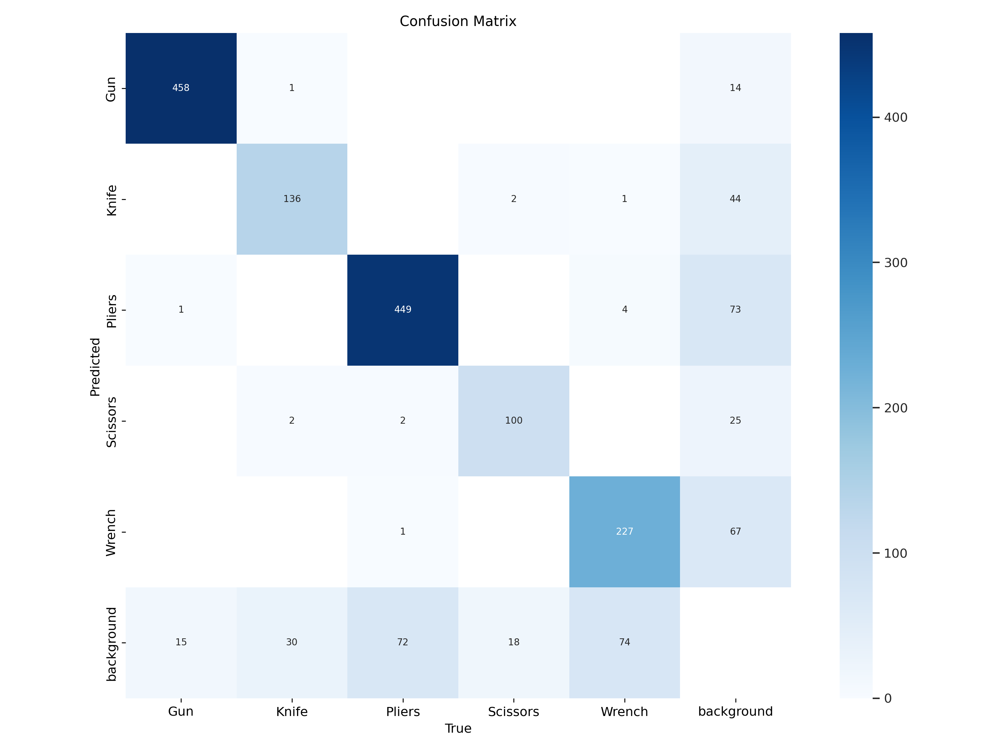

In [39]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train72/confusion_matrix.png', width=700)



image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P04090_jpg.rf.ce056770169b83e8da0eb5bcf90a7e2f.jpg: 640x352 1 Knife, 1 Wrench, 8.8ms
Speed: 1.5ms preprocess, 8.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 352)


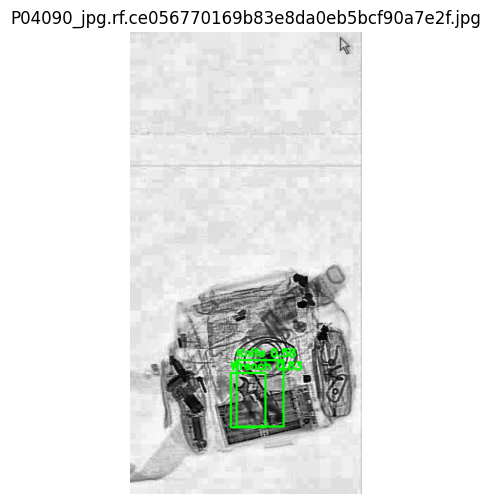


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00566_jpg.rf.f6f7244b34dc19538bbbcf6ee3a0afe9.jpg: 640x640 2 Knifes, 7.1ms
Speed: 4.3ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


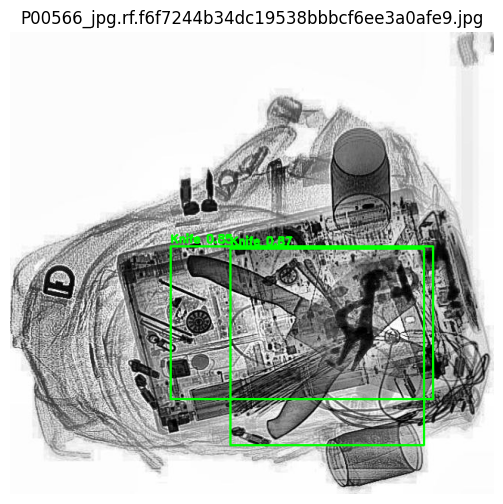


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P08192_jpg.rf.7d44114194ea0b181e8b6f624e3b43e5.jpg: 576x640 1 Scissors, 7.7ms
Speed: 4.0ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


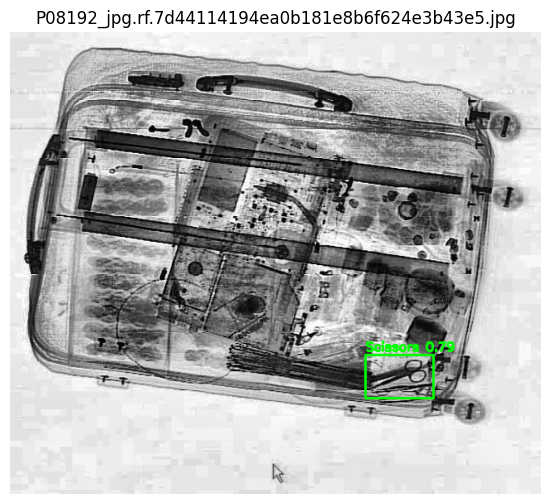


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00937_jpg.rf.e5686c9d95f2bbe37f7481ad72b65af5.jpg: 640x608 2 Guns, 1 Wrench, 7.6ms
Speed: 2.9ms preprocess, 7.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 608)


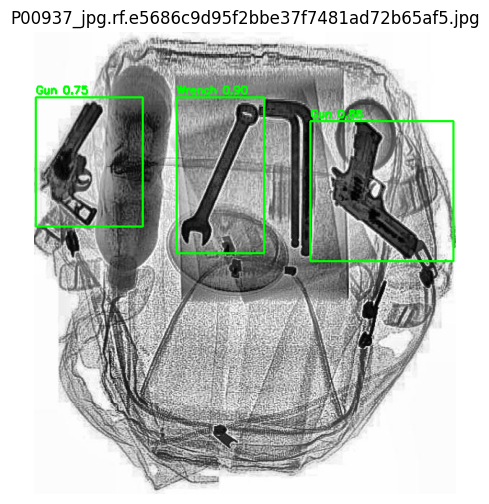


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P01417_jpg.rf.77884899d17be8dc4450d0cd49fc31c0.jpg: 640x640 2 Guns, 7.0ms
Speed: 1.7ms preprocess, 7.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


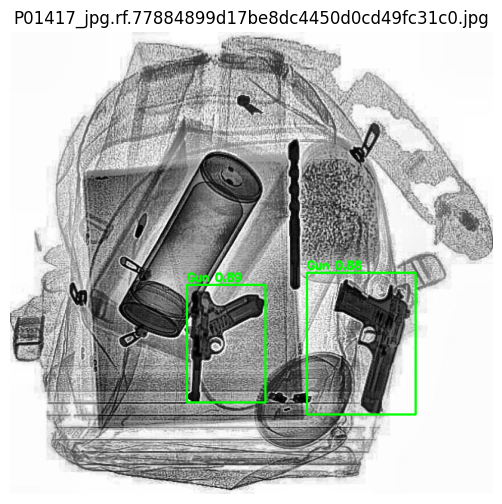

In [40]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model7(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()



0: 544x640 1 Wrench, 8.6ms
Speed: 2.5ms preprocess, 8.6ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)


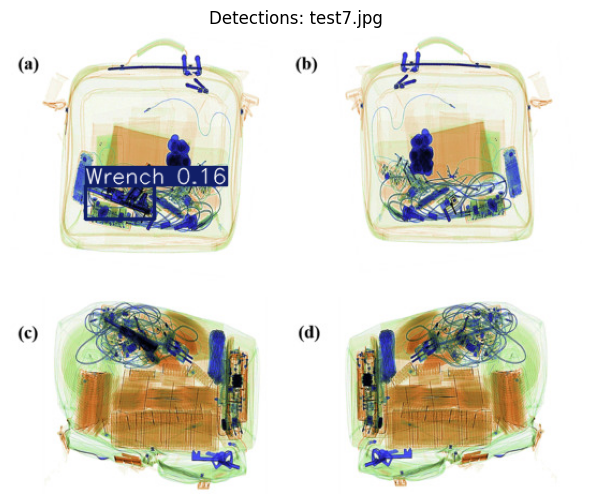


0: 640x640 3 Knifes, 7.6ms
Speed: 2.8ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


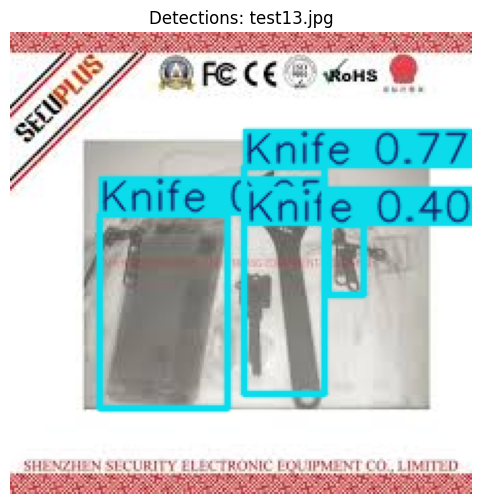


0: 512x640 (no detections), 7.6ms
Speed: 2.6ms preprocess, 7.6ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


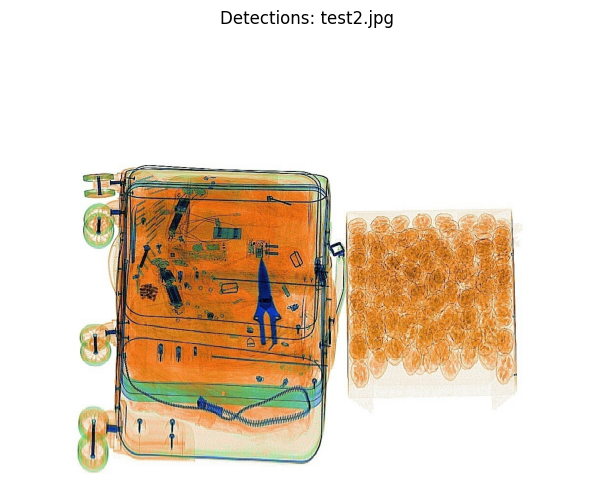


0: 576x640 3 Guns, 1 Knife, 6 Plierss, 7.1ms
Speed: 3.0ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)


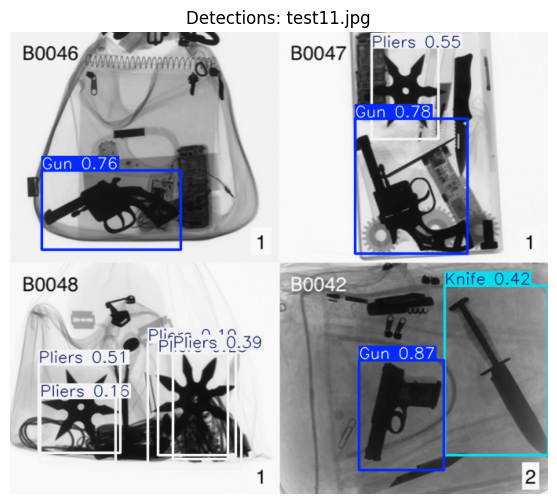


0: 608x640 3 Guns, 7.9ms
Speed: 3.2ms preprocess, 7.9ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)


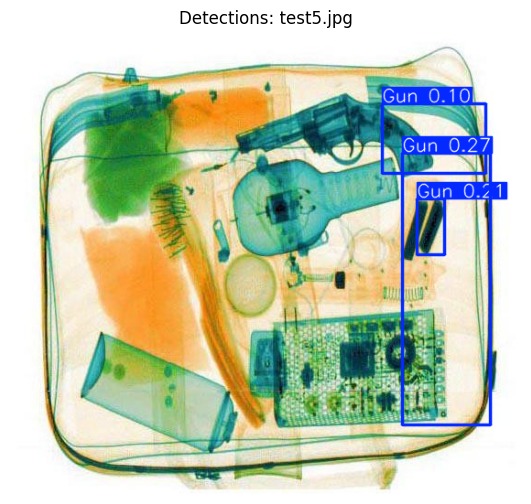


0: 448x640 2 Guns, 3 Knifes, 1 Scissors, 7.7ms
Speed: 2.4ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


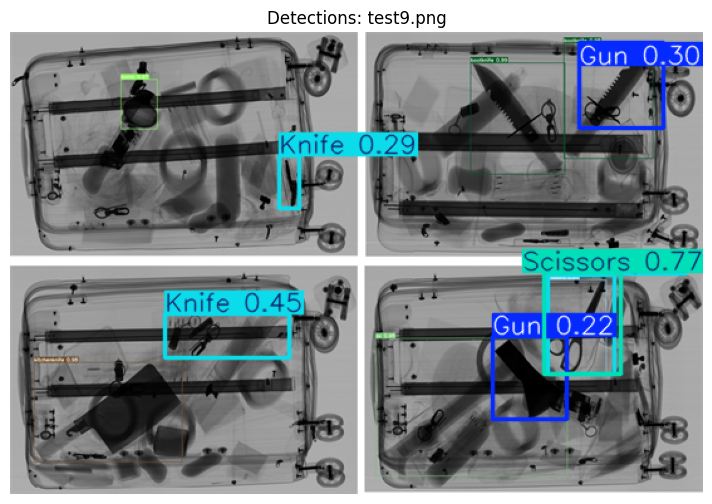


0: 512x640 (no detections), 7.1ms
Speed: 2.7ms preprocess, 7.1ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


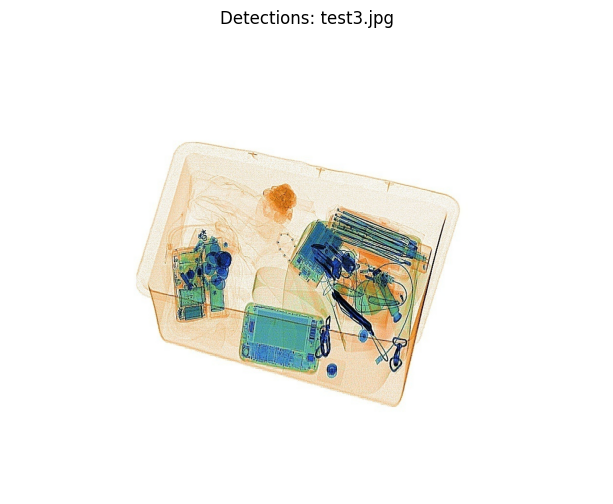


0: 640x576 1 Gun, 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 576)


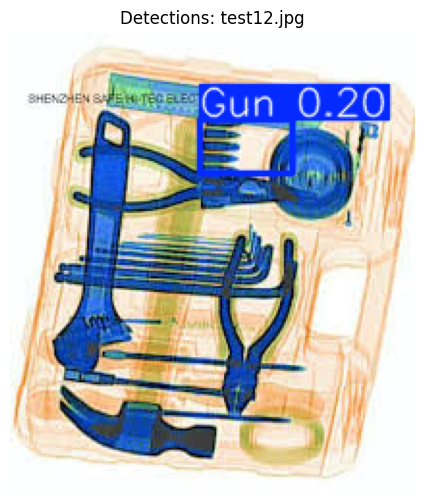


0: 288x640 4 Guns, 8.5ms
Speed: 2.1ms preprocess, 8.5ms inference, 1.3ms postprocess per image at shape (1, 3, 288, 640)


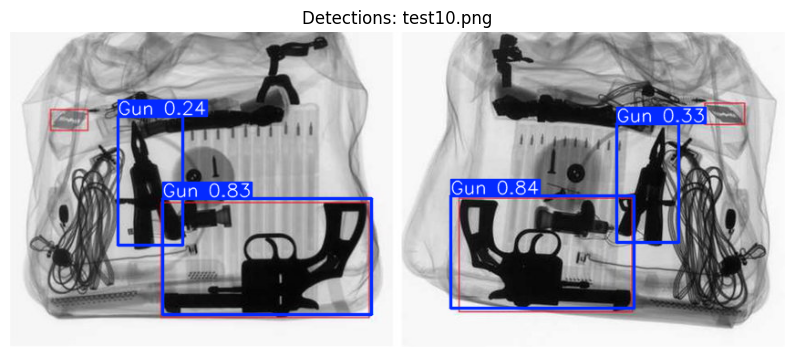


0: 224x640 (no detections), 8.5ms
Speed: 1.5ms preprocess, 8.5ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)


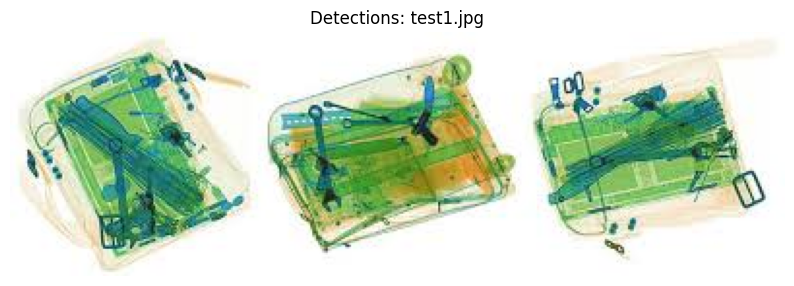


0: 512x640 (no detections), 6.9ms
Speed: 2.7ms preprocess, 6.9ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


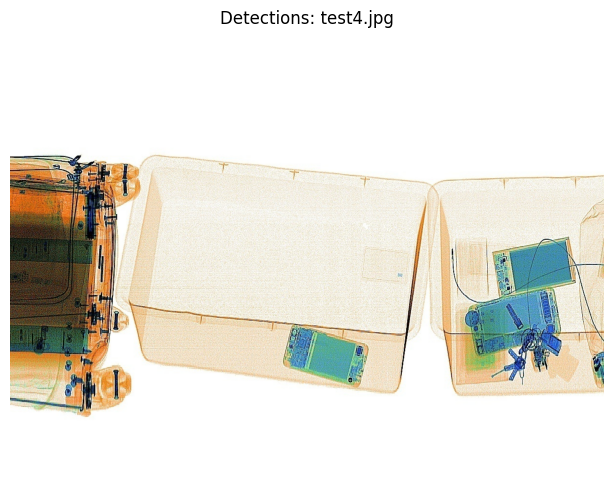


0: 640x416 1 Knife, 7.7ms
Speed: 3.7ms preprocess, 7.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 416)


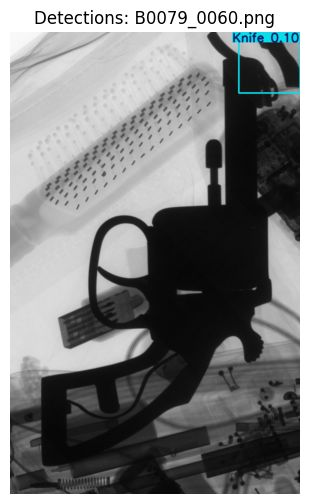


0: 384x640 (no detections), 10.7ms
Speed: 1.7ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


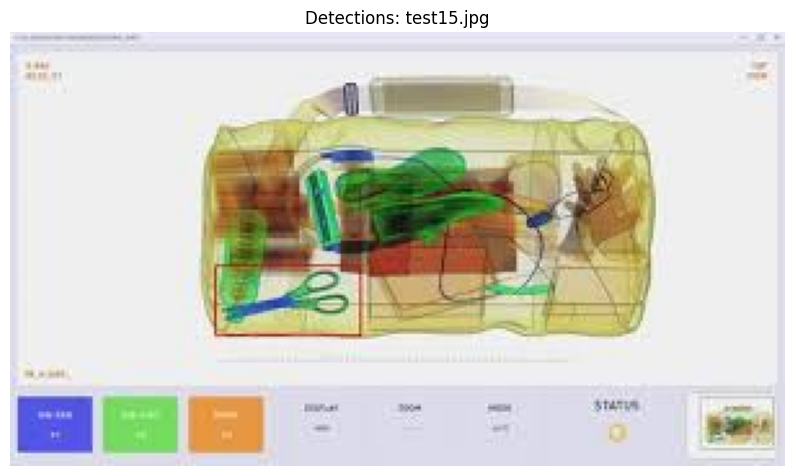


0: 640x576 (no detections), 7.2ms
Speed: 3.0ms preprocess, 7.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)


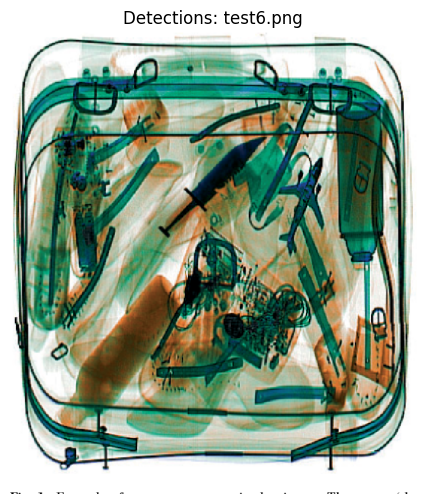

In [41]:
import os
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images

# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model7(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()


## Model 8

In [3]:
from ultralytics import YOLO

model8 = YOLO("yolov8n.pt")  # Load pre-trained model
model8.train(data="/kaggle/input/sixray/sixray_v3/data.yaml", epochs=40, batch=32)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 111MB/s]


Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/input/sixray/sixray_v3/data.yaml, epochs=40, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True,

100%|██████████| 755k/755k [00:00<00:00, 27.4MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 115MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/sixray/sixray_v3/train/labels... 11638 images, 115 backgrounds, 0 corrupt: 100%|██████████| 11638/11638 [00:41<00:00, 280.33it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/sixray/sixray_v3/valid/labels... 1662 images, 2 backgrounds, 0 corrupt: 100%|██████████| 1662/1662 [00:06<00:00, 260.99it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/valid is not writeable, cache not saved.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      3.78G      1.859      2.951      1.727         74        640: 100%|██████████| 364/364 [02:01<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:10<00:00,  2.52it/s]


                   all       1662       3176      0.435      0.434      0.405      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      7.62G      1.758      2.106      1.673         62        640: 100%|██████████| 364/364 [01:58<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.12it/s]

                   all       1662       3176      0.563      0.477      0.512      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      7.62G      1.709      1.889      1.655         46        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.05it/s]


                   all       1662       3176      0.506      0.424      0.442      0.215

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      7.62G      1.695      1.811      1.655         64        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.09it/s]


                   all       1662       3176      0.598        0.5      0.554        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      7.62G       1.63      1.675        1.6         64        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.13it/s]

                   all       1662       3176      0.715      0.561      0.644      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      7.62G      1.574      1.568      1.566         74        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.712      0.587      0.675      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      7.62G      1.541      1.505      1.542         72        640: 100%|██████████| 364/364 [01:56<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.07it/s]

                   all       1662       3176      0.713      0.627      0.696      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      7.62G      1.507      1.442      1.528         68        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.05it/s]

                   all       1662       3176      0.753      0.618      0.719      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      7.62G      1.475      1.405      1.502         75        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  2.99it/s]

                   all       1662       3176      0.758      0.632      0.724      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      7.62G      1.453      1.353      1.481         79        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.797      0.634      0.756      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      7.62G      1.431      1.329      1.469         74        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.11it/s]

                   all       1662       3176      0.787      0.667      0.758      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      7.62G      1.408      1.282      1.452         92        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.14it/s]

                   all       1662       3176      0.797       0.68      0.772      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      7.62G      1.386      1.248       1.43         74        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.15it/s]

                   all       1662       3176      0.817      0.698      0.793      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      7.62G      1.369      1.227      1.421         71        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.10it/s]

                   all       1662       3176      0.809      0.722      0.793      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      7.62G      1.353      1.201      1.405         69        640: 100%|██████████| 364/364 [01:56<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.15it/s]

                   all       1662       3176       0.83      0.692      0.795      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      7.62G      1.332      1.163      1.393         68        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.11it/s]

                   all       1662       3176      0.828      0.738      0.814      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      7.62G      1.309      1.137      1.371         85        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.10it/s]

                   all       1662       3176      0.847      0.712      0.816      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      7.62G      1.302      1.117      1.367         79        640: 100%|██████████| 364/364 [01:56<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.21it/s]

                   all       1662       3176       0.86      0.718      0.827      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      7.62G      1.293      1.109      1.362         70        640: 100%|██████████| 364/364 [01:56<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.15it/s]

                   all       1662       3176      0.843      0.745      0.831      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      7.62G      1.272      1.088      1.353         76        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.874       0.73      0.843      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      7.62G      1.255      1.066      1.335         75        640: 100%|██████████| 364/364 [01:56<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.18it/s]

                   all       1662       3176      0.863      0.768      0.851       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      7.62G      1.249      1.053       1.33         71        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.19it/s]

                   all       1662       3176      0.869      0.758      0.852      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      7.62G      1.241      1.039      1.326         70        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.851      0.772      0.858      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      7.62G      1.225      1.025      1.312         89        640: 100%|██████████| 364/364 [01:56<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.09it/s]

                   all       1662       3176      0.875      0.765      0.859      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      7.62G      1.211      1.002      1.303         70        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.07it/s]

                   all       1662       3176      0.883      0.764      0.863      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      7.62G      1.197     0.9875       1.29         65        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.08it/s]

                   all       1662       3176      0.854      0.799      0.866       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      7.62G      1.183     0.9669      1.282         72        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.23it/s]

                   all       1662       3176      0.869      0.794      0.867      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      7.62G      1.175     0.9545      1.277         82        640: 100%|██████████| 364/364 [01:56<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.885       0.78      0.868      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      7.62G      1.158     0.9414      1.263         68        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.17it/s]

                   all       1662       3176      0.896      0.777       0.87      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      7.62G      1.156     0.9361      1.263         85        640: 100%|██████████| 364/364 [01:55<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.24it/s]

                   all       1662       3176      0.879      0.806      0.876      0.606


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      7.62G      1.039     0.7168      1.225         42        640: 100%|██████████| 364/364 [01:56<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.20it/s]

                   all       1662       3176      0.896      0.797       0.88      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      7.62G      1.017     0.6942      1.207         42        640: 100%|██████████| 364/364 [01:54<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.15it/s]

                   all       1662       3176      0.883      0.803      0.879      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      7.62G      0.999     0.6799      1.193         40        640: 100%|██████████| 364/364 [01:54<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.12it/s]

                   all       1662       3176      0.885      0.803      0.884      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      7.62G     0.9777     0.6615      1.179         42        640: 100%|██████████| 364/364 [01:54<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.12it/s]

                   all       1662       3176      0.894      0.814      0.887      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      7.62G     0.9654     0.6521      1.171         33        640: 100%|██████████| 364/364 [01:54<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.23it/s]

                   all       1662       3176        0.9      0.801      0.885      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      7.62G     0.9513     0.6341      1.158         57        640: 100%|██████████| 364/364 [01:54<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.23it/s]

                   all       1662       3176      0.898      0.802      0.891      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      7.62G     0.9358      0.624      1.151         34        640: 100%|██████████| 364/364 [01:54<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.22it/s]

                   all       1662       3176      0.917      0.796      0.889      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      7.62G     0.9201     0.6129      1.138         48        640: 100%|██████████| 364/364 [01:54<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.09it/s]

                   all       1662       3176      0.912      0.799      0.891      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      7.62G     0.9139     0.6071      1.138         34        640: 100%|██████████| 364/364 [01:54<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.16it/s]

                   all       1662       3176      0.911        0.8      0.892      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      7.62G     0.9038     0.5969       1.13         34        640: 100%|██████████| 364/364 [01:54<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:08<00:00,  3.21it/s]

                   all       1662       3176       0.93      0.786       0.89       0.64



40 epochs completed in 1.386 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:10<00:00,  2.59it/s]


                   all       1662       3176       0.91        0.8      0.892       0.64
                   Gun        551        888       0.96       0.94      0.981      0.759
                 Knife        291        442      0.894      0.771      0.861      0.609
                Pliers        794       1110      0.919      0.804      0.904      0.643
              Scissors        178        206      0.911      0.791      0.884      0.597
                Wrench        392        530      0.868      0.694      0.829      0.594


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 1.7ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ff2f582b010>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

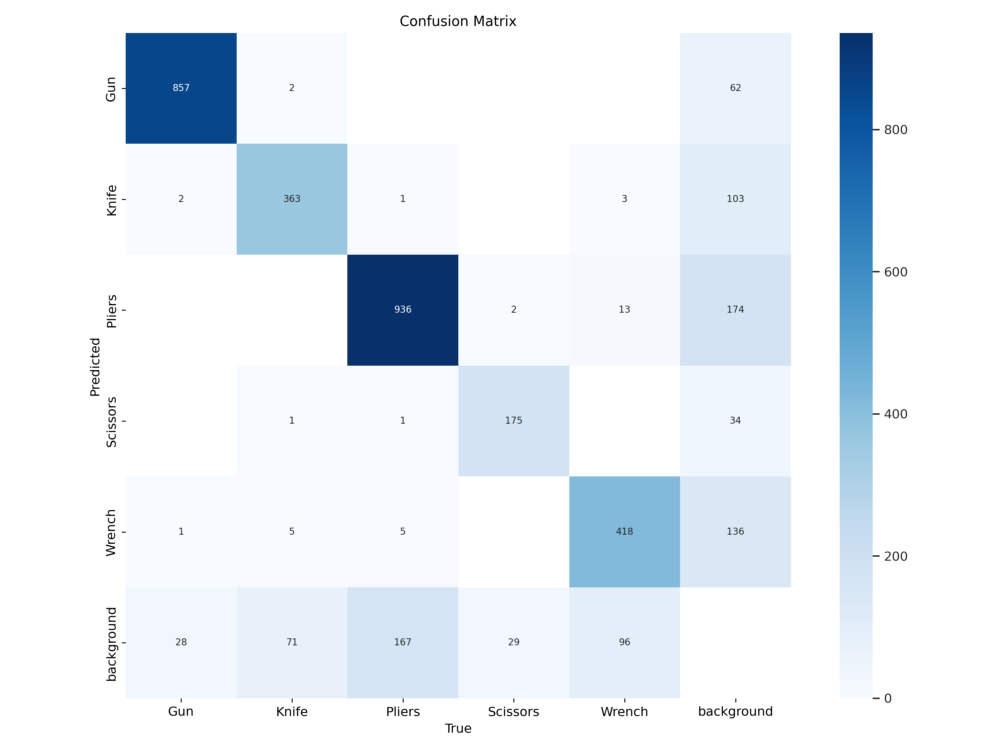

In [4]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train8/confusion_matrix.png', width=700)


In [6]:
model8.val(data="/kaggle/input/sixray/sixray_v3/data.yaml",split='test')


Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/sixray/sixray_v3/test/labels... 831 images, 2 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:03<00:00, 249.50it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/sixray/sixray_v3/test is not writeable, cache not saved.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:06<00:00,  4.02it/s]


                   all        831       1593      0.911      0.801      0.887      0.635
                   Gun        288        474      0.974       0.96      0.981      0.763
                 Knife        111        169      0.901      0.781      0.865      0.594
                Pliers        387        524      0.927      0.803      0.907      0.662
              Scissors         97        120       0.88      0.796      0.875      0.595
                Wrench        214        306      0.873      0.663      0.806      0.564


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.5ms preprocess, 2.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ff2f4d1f700>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

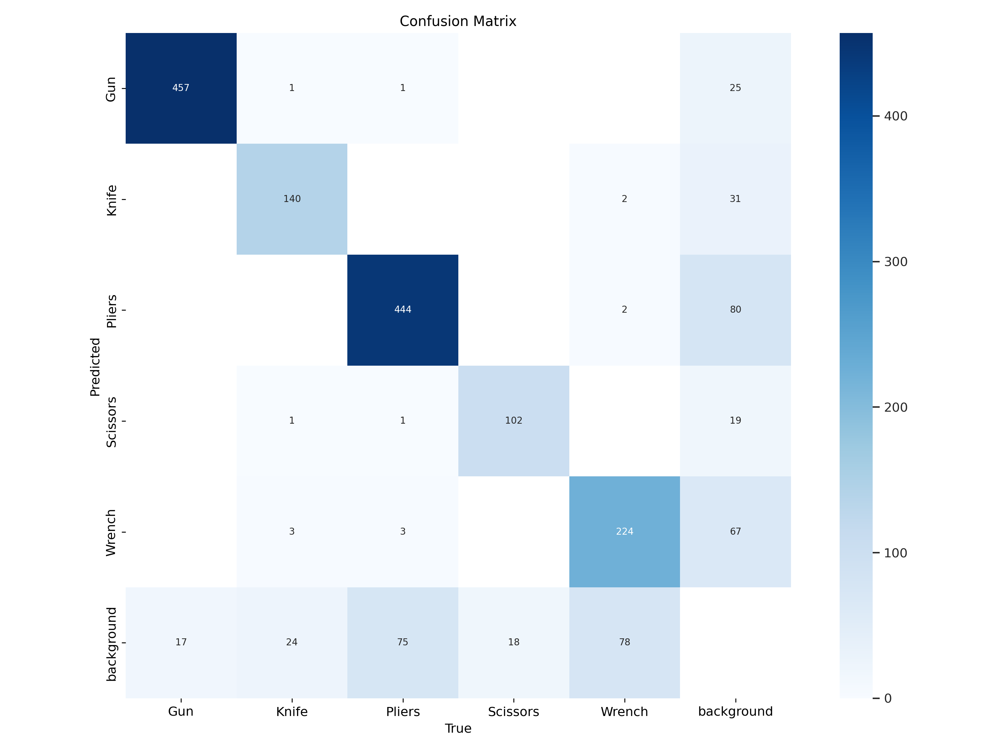

In [7]:
from IPython.display import Image as IPyImage

IPyImage(filename='/kaggle/working/runs/detect/train82/confusion_matrix.png', width=700)



image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P04090_jpg.rf.ce056770169b83e8da0eb5bcf90a7e2f.jpg: 640x352 1 Knife, 1 Wrench, 35.1ms
Speed: 1.4ms preprocess, 35.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 352)


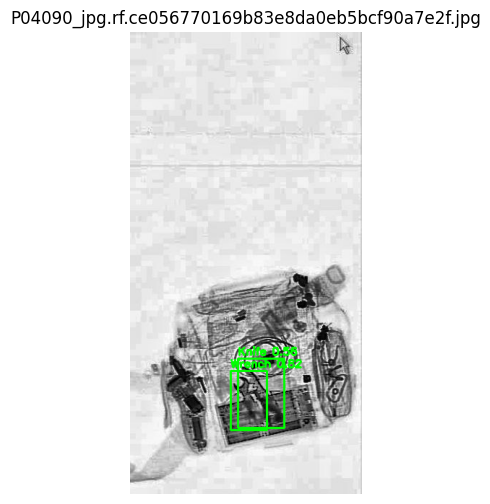


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00566_jpg.rf.f6f7244b34dc19538bbbcf6ee3a0afe9.jpg: 640x640 2 Knifes, 6.7ms
Speed: 2.7ms preprocess, 6.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


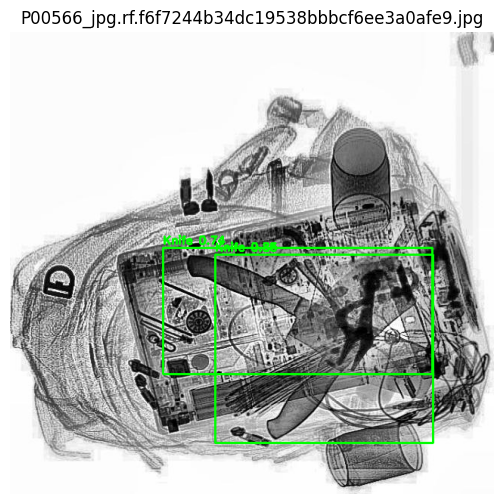


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P08192_jpg.rf.7d44114194ea0b181e8b6f624e3b43e5.jpg: 576x640 1 Scissors, 33.6ms
Speed: 1.5ms preprocess, 33.6ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)


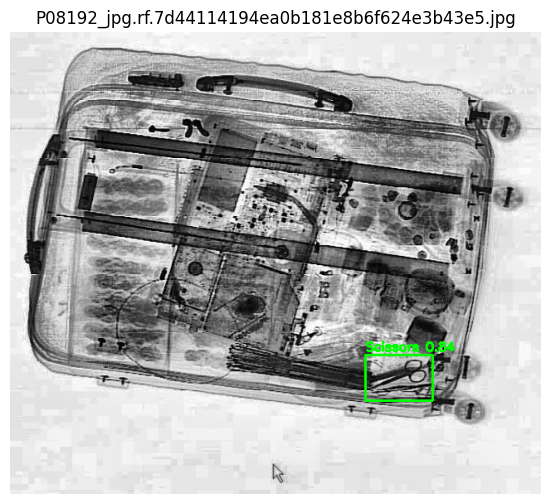


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P00937_jpg.rf.e5686c9d95f2bbe37f7481ad72b65af5.jpg: 640x608 2 Guns, 1 Wrench, 33.9ms
Speed: 1.6ms preprocess, 33.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 608)


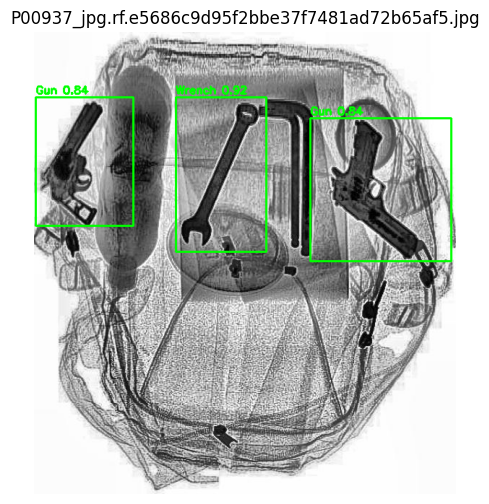


image 1/1 /kaggle/input/sixray/sixray_v3/test/images/P01417_jpg.rf.77884899d17be8dc4450d0cd49fc31c0.jpg: 640x640 2 Guns, 7.1ms
Speed: 1.9ms preprocess, 7.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


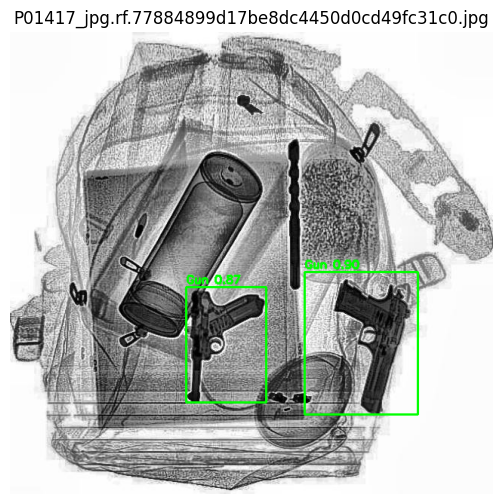

In [8]:
import cv2
import os
import random
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

# Define custom labels (ensure this matches your training dataset)
custom_labels = ['Gun', 'Knife', 'Pliers', 'Scissors', 'Wrench']

# Path to your image folder
image_folder = '/kaggle/input/sixray/sixray_v3/test/images'

# Get a list of image files
image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select images
num_images = 5  # Adjust as needed
random_images = random.sample(image_files, min(num_images, len(image_files)))

for image_name in random_images:
    image_path = os.path.join(image_folder, image_name)

    # Run YOLO prediction
    results = model8(image_path)

    # Load image using OpenCV
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    # Draw detections
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get bounding box coordinates
            confidence = float(box.conf[0])  # Confidence score
            class_id = int(box.cls[0])  # Class index
            label = custom_labels[class_id] if class_id < len(custom_labels) else "Unknown"

            # Draw bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(image, f"{label} {confidence:.2f}", (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(image_name)
    plt.show()



0: 544x640 2 Wrenchs, 33.7ms
Speed: 2.2ms preprocess, 33.7ms inference, 1.2ms postprocess per image at shape (1, 3, 544, 640)


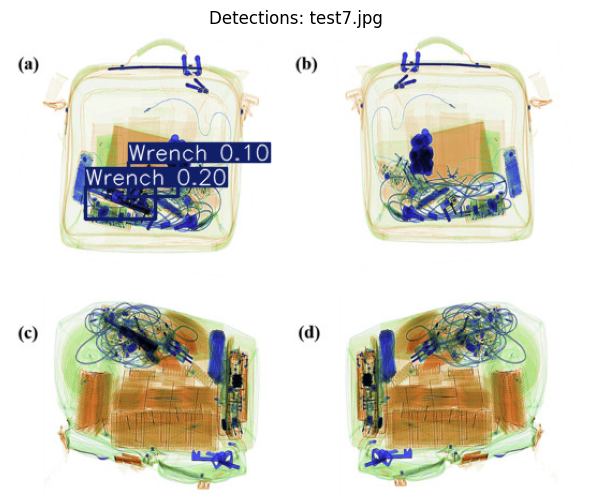


0: 640x640 1 Knife, 7.2ms
Speed: 2.3ms preprocess, 7.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


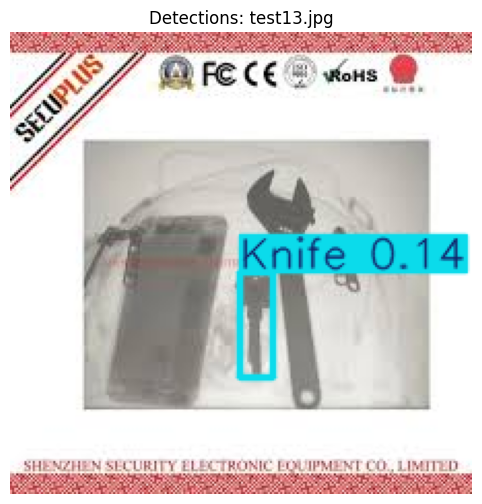


0: 512x640 (no detections), 32.8ms
Speed: 2.5ms preprocess, 32.8ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


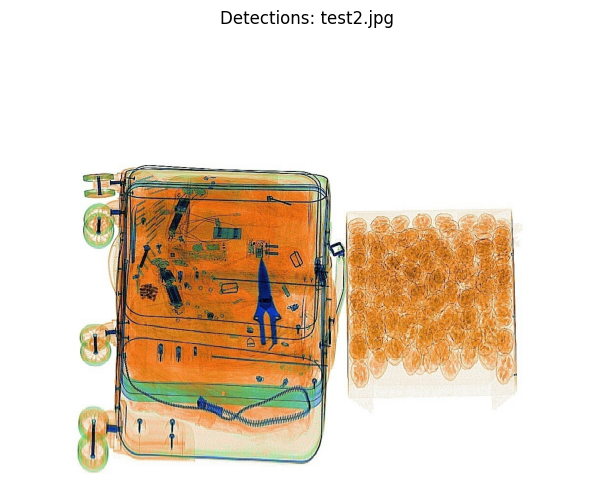


0: 576x640 3 Guns, 4 Plierss, 7.1ms
Speed: 2.4ms preprocess, 7.1ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)


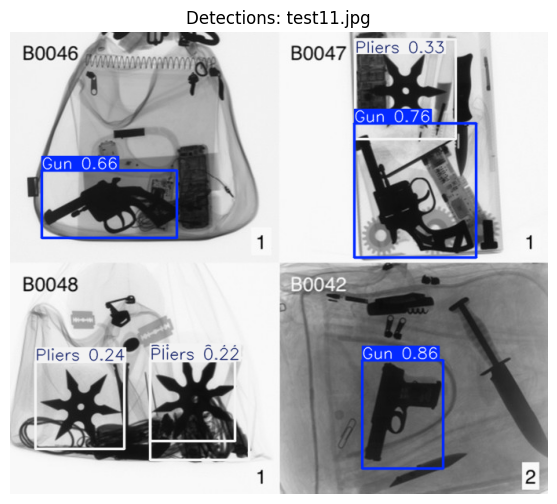


0: 608x640 8 Guns, 33.0ms
Speed: 2.5ms preprocess, 33.0ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)


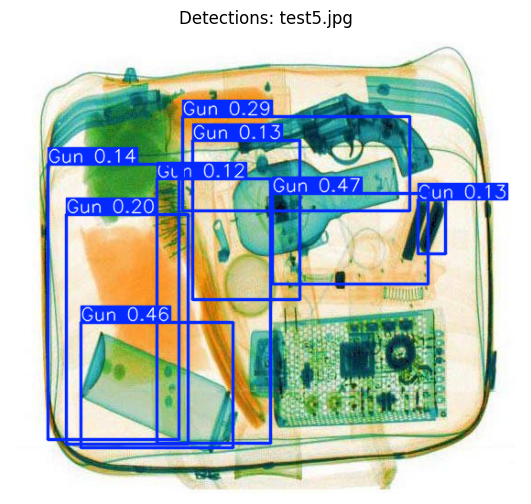


0: 448x640 2 Guns, 5 Knifes, 1 Scissors, 34.2ms
Speed: 2.0ms preprocess, 34.2ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


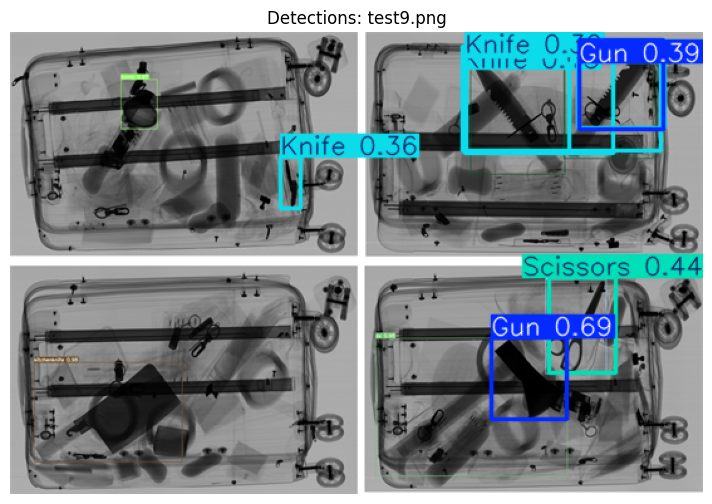


0: 512x640 1 Pliers, 1 Wrench, 6.9ms
Speed: 2.6ms preprocess, 6.9ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)


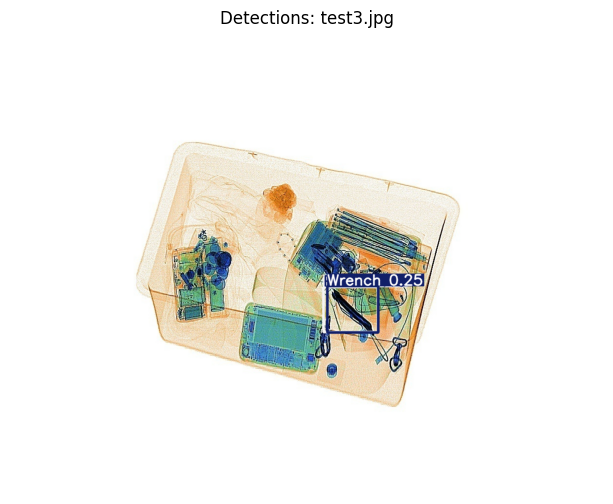


0: 640x576 (no detections), 33.6ms
Speed: 2.1ms preprocess, 33.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 576)


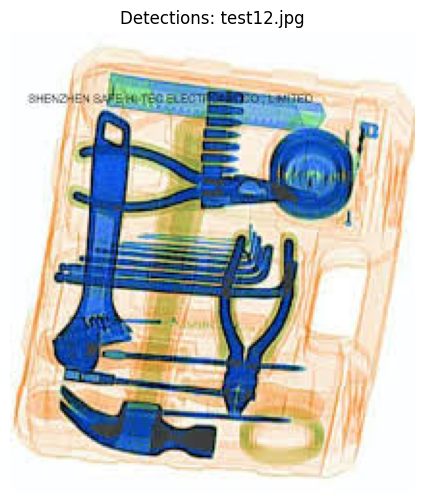


0: 288x640 4 Guns, 33.2ms
Speed: 1.6ms preprocess, 33.2ms inference, 1.3ms postprocess per image at shape (1, 3, 288, 640)


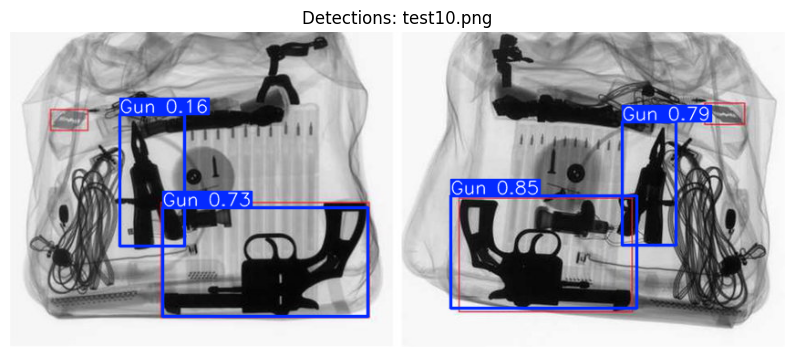


0: 224x640 (no detections), 32.4ms
Speed: 1.3ms preprocess, 32.4ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


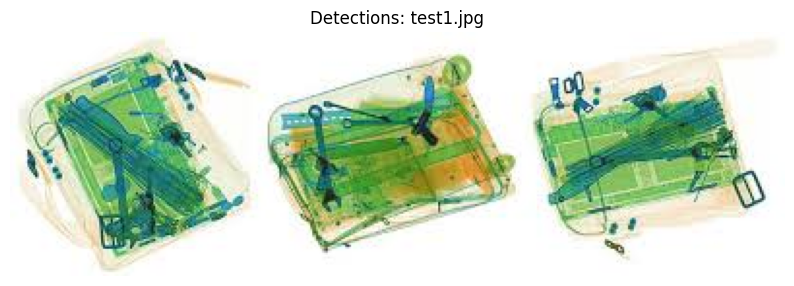


0: 512x640 (no detections), 7.0ms
Speed: 2.8ms preprocess, 7.0ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)


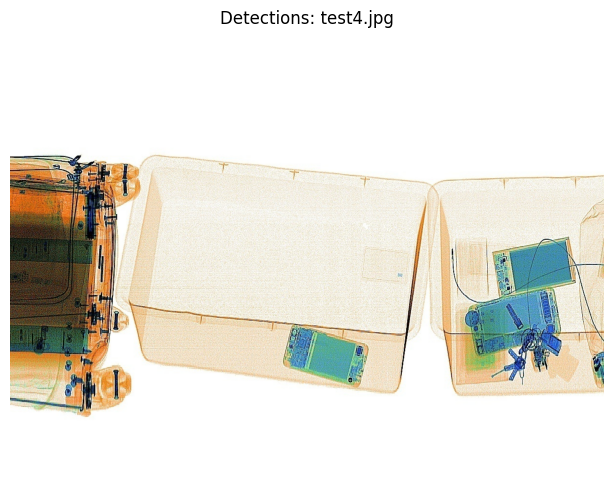


0: 640x416 (no detections), 33.7ms
Speed: 2.3ms preprocess, 33.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 416)


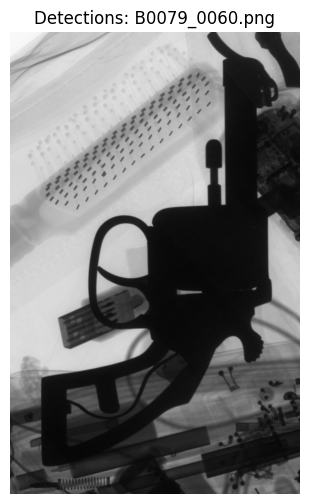


0: 384x640 (no detections), 33.0ms
Speed: 1.6ms preprocess, 33.0ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


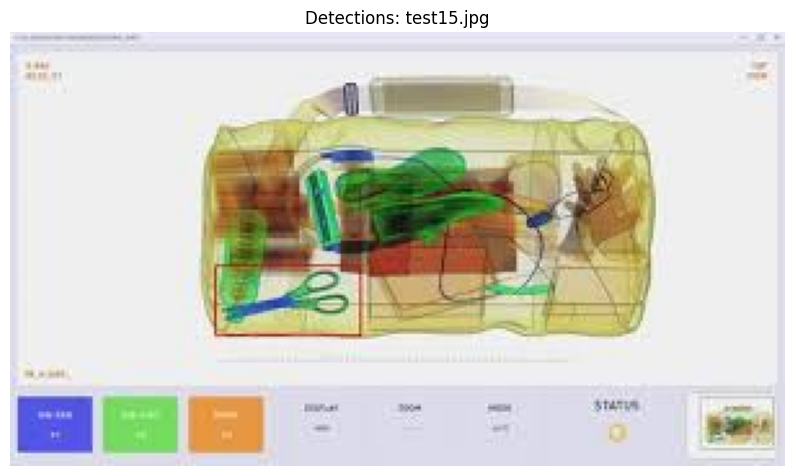


0: 640x576 (no detections), 6.8ms
Speed: 2.6ms preprocess, 6.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 576)


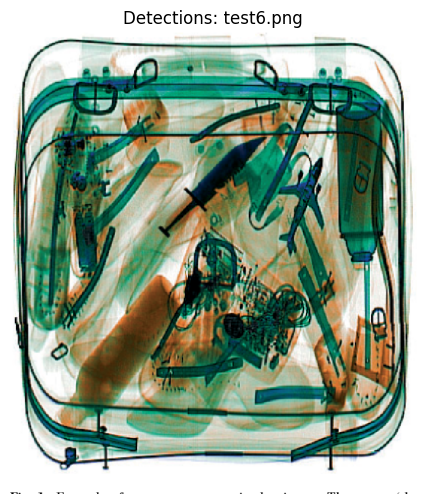

In [9]:
import os
# Define input and output folders
input_folder = "/kaggle/input/tests-xray/"  # Folder containing test images

# Get list of image files
image_files = [f for f in os.listdir(input_folder) if f.endswith((".jpg", ".png", ".jpeg"))]

# Process each image
for image_file in image_files:
    image_path = os.path.join(input_folder, image_file)

    # Read image
    image = cv2.imread(image_path)
    
    # Run YOLO detection
    results = model8(image,conf=.1)

    # Get the image with bounding boxes and labels
    output_image = results[0].plot()

    # Convert BGR to RGB for Matplotlib
    output_image = cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB)

    # Display the image using Matplotlib
    plt.figure(figsize=(10, 6))
    plt.imshow(output_image)
    plt.axis("off")  # Hide axes
    plt.title(f"Detections: {image_file}")  # Show filename
    plt.show()
